# OpenAI API Labeling

## Count and sample from labeled dataset

In [1]:
import json
import random
from collections import Counter
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import base64
from openai import OpenAI
from dotenv import load_dotenv
from tqdm import tqdm
import re

In [4]:
HAND_LABELED_PATH = "../json_txt/hand_labeled_annotations_redo.json"
# SAMPLED_OUT_PATH = "../sample_100_for_openai_lights.json"
SAMPLED_OUT_PATH = "../sample_100_for_openai_lights_test.json"


with open(HAND_LABELED_PATH) as f:
    data = json.load(f)

combo_counts = Counter((d["turn_signal"], d["tail_light"]) for d in data)
print("Class distribution:")
for combo, count in combo_counts.items():
    print(f"{combo}: {count}")

Class distribution:
('none', 'off'): 8025
('none', 'unclear'): 254
('none', 'not_visible'): 204
('none', 'on'): 1219
('unclear', 'unclear'): 82
('unclear', 'on'): 81
('right', 'on'): 18
('unclear', 'off'): 28
('right', 'off'): 24
('left', 'off'): 30
('left', 'on'): 19
('right', 'unclear'): 10
('left', 'unclear'): 6


In [5]:
sampling_scheme = {
    ("none", "off"): 30,
    ("left", "on"): 15,
    ("left", "unclear"): 6,
    ("left", "off"): 20,
    ("right", "off"): 20,
    ("right", "on"): 15,
    ("right", "unclear"): 10,
    ("none", "on"): 7,
    ("none", "unclear"): 7
}

In [6]:
sampled = []
for combo, n in sampling_scheme.items():
    subset = [d for d in data if (d["turn_signal"], d["tail_light"]) == combo]
    if len(subset) < n:
        print(f"Only found {len(subset)} samples for {combo}, taking all available.")
    sampled.extend(random.sample(subset, min(len(subset), n)))

print(f"\nTotal sampled: {len(sampled)}")
with open(SAMPLED_OUT_PATH, "w") as f:
    json.dump(sampled, f, indent=2)
print(f"Saved sampled subset to {SAMPLED_OUT_PATH}")


Total sampled: 130
Saved sampled subset to ../sample_100_for_openai_lights_test.json


## Run the OpenAI API on the sampled images

In [7]:
load_dotenv()
client = OpenAI(api_key=os.getenv("OPENAI_API_KEY"))

SAMPLED_PATH = "../json_txt/sample_100_for_openai_lights_test.json"
LOCAL_BASE = "../sampled_images" 

In [8]:
def encode_image(image_path):
    with open(image_path, "rb") as img:
        return base64.b64encode(img.read()).decode("utf-8")

## gpt-4o-mini & prompt 1

Prompt 1:

```
"You are an advanced image analysis model. Look at the car image and determine:\n"
"1. turn_signal — one of: left, right, unclear, none, both\n"
"2. tail_light — one of: on, off, unclear \n\n"
"Return only valid JSON in this format:\n"
"{\n"
"  \"turn_signal\": \"left\",\n"
"  \"tail_light\": \"on\"\n"
"}"
```

Approx time: 7:44pm October 27, 2025

In [9]:
OUTPUT_FILE = "../json_txt/gpt-4o-mini_prompt1.json"

In [8]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none, both\n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o-mini",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [9]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [10]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/100 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:   1%|▏                      | 1/100 [00:01<02:48,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:   2%|▍                      | 2/100 [00:03<03:08,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0137653.jpg


Classifying images:   3%|▋                      | 3/100 [00:05<03:13,  1.99s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-09-54_mapping_tartu_streets/camera_fl/predict/crops/car/012056.jpg


Classifying images:   4%|▉                      | 4/100 [00:07<02:42,  1.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:   5%|█▏                     | 5/100 [00:09<02:56,  1.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:   6%|█▍                     | 6/100 [00:10<02:47,  1.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-37-46_mapping_tartu_streets/camera_fl/predict/crops/car/0628284.jpg


Classifying images:   7%|█▌                     | 7/100 [00:12<02:44,  1.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:   8%|█▊                     | 8/100 [00:13<02:27,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:   9%|██                     | 9/100 [00:15<02:37,  1.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  10%|██▏                   | 10/100 [00:17<02:22,  1.58s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  11%|██▍                   | 11/100 [00:18<02:05,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  12%|██▋                   | 12/100 [00:19<01:53,  1.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  13%|██▊                   | 13/100 [00:20<01:55,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  14%|███                   | 14/100 [00:22<02:18,  1.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  15%|███▎                  | 15/100 [00:24<02:09,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  16%|███▌                  | 16/100 [00:26<02:16,  1.62s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  17%|███▋                  | 17/100 [00:26<01:56,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  18%|███▉                  | 18/100 [00:27<01:41,  1.24s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  19%|████▏                 | 19/100 [00:28<01:39,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  20%|████▍                 | 20/100 [00:30<01:41,  1.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  21%|████▌                 | 21/100 [00:31<01:36,  1.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-35-00_mapping_tartu_streets/camera_fl/predict/crops/car/0381914.jpg


Classifying images:  22%|████▊                 | 22/100 [00:32<01:37,  1.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  23%|█████                 | 23/100 [00:33<01:34,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  24%|█████▎                | 24/100 [00:35<01:50,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0087872.jpg


Classifying images:  25%|█████▌                | 25/100 [00:37<01:50,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  26%|█████▋                | 26/100 [00:38<01:35,  1.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  27%|█████▉                | 27/100 [00:39<01:28,  1.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  28%|██████▏               | 28/100 [00:40<01:26,  1.20s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_narrow_front/predict/crops/car/034470.jpg


Classifying images:  29%|██████▍               | 29/100 [00:41<01:24,  1.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  30%|██████▌               | 30/100 [00:43<01:37,  1.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0660002.jpg


Classifying images:  31%|██████▊               | 31/100 [00:44<01:31,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  32%|███████               | 32/100 [00:46<01:33,  1.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  33%|███████▎              | 33/100 [00:47<01:23,  1.25s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0189483.jpg


Classifying images:  34%|███████▍              | 34/100 [00:48<01:27,  1.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0817932.jpg


Classifying images:  35%|███████▋              | 35/100 [00:50<01:36,  1.48s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  36%|███████▉              | 36/100 [00:52<01:35,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  37%|████████▏             | 37/100 [00:53<01:33,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  38%|████████▎             | 38/100 [00:54<01:26,  1.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  39%|████████▌             | 39/100 [00:56<01:33,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  40%|████████▊             | 40/100 [00:58<01:33,  1.56s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  41%|█████████             | 41/100 [00:59<01:29,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_right/predict/crops/car/0587347.jpg


Classifying images:  42%|█████████▏            | 42/100 [01:00<01:23,  1.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  43%|█████████▍            | 43/100 [01:02<01:27,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  44%|█████████▋            | 44/100 [01:04<01:24,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  45%|█████████▉            | 45/100 [01:05<01:16,  1.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  46%|██████████            | 46/100 [01:06<01:17,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  47%|██████████▎           | 47/100 [01:07<01:12,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  48%|██████████▌           | 48/100 [01:09<01:14,  1.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  49%|██████████▊           | 49/100 [01:10<01:12,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/0168752.jpg


Classifying images:  50%|███████████           | 50/100 [01:12<01:08,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  51%|███████████▏          | 51/100 [01:13<01:03,  1.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  52%|███████████▍          | 52/100 [01:15<01:15,  1.56s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  53%|███████████▋          | 53/100 [01:16<01:11,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  54%|███████████▉          | 54/100 [01:18<01:09,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  55%|████████████          | 55/100 [01:19<01:02,  1.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0174873.jpg


Classifying images:  56%|████████████▎         | 56/100 [01:20<00:58,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  57%|████████████▌         | 57/100 [01:22<00:58,  1.36s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▊         | 58/100 [01:23<00:56,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  59%|████████████▉         | 59/100 [01:24<00:56,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  60%|█████████████▏        | 60/100 [01:25<00:51,  1.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  61%|█████████████▍        | 61/100 [01:27<00:48,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  62%|█████████████▋        | 62/100 [01:28<00:50,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  63%|█████████████▊        | 63/100 [01:30<00:57,  1.55s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-03-44_mapping_tartu_streets/camera_fl/predict/crops/car/00640512.jpg


Classifying images:  64%|██████████████        | 64/100 [01:32<00:55,  1.55s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  65%|██████████████▎       | 65/100 [01:34<01:05,  1.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457733.jpg


Classifying images:  66%|██████████████▌       | 66/100 [01:37<01:13,  2.17s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  67%|██████████████▋       | 67/100 [01:40<01:14,  2.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  68%|██████████████▉       | 68/100 [01:41<01:01,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  69%|███████████████▏      | 69/100 [01:44<01:15,  2.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  70%|███████████████▍      | 70/100 [01:46<01:06,  2.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  71%|███████████████▌      | 71/100 [01:50<01:22,  2.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  72%|███████████████▊      | 72/100 [01:52<01:09,  2.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  73%|████████████████      | 73/100 [01:53<00:54,  2.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0170983.jpg


Classifying images:  74%|████████████████▎     | 74/100 [01:54<00:47,  1.81s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  75%|████████████████▌     | 75/100 [01:56<00:41,  1.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  76%|████████████████▋     | 76/100 [01:57<00:35,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  77%|████████████████▉     | 77/100 [01:58<00:32,  1.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  78%|█████████████████▏    | 78/100 [01:59<00:31,  1.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  79%|█████████████████▍    | 79/100 [02:01<00:29,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  80%|█████████████████▌    | 80/100 [02:05<00:42,  2.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  81%|█████████████████▊    | 81/100 [02:06<00:38,  2.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|██████████████████    | 82/100 [02:11<00:51,  2.87s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  83%|██████████████████▎   | 83/100 [02:12<00:38,  2.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  84%|██████████████████▍   | 84/100 [02:13<00:31,  2.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  85%|██████████████████▋   | 85/100 [02:20<00:49,  3.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████▉   | 86/100 [02:21<00:38,  2.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-18-40_mapping_tartu_streets/camera_fl/predict/crops/car/0545602.jpg


Classifying images:  87%|███████████████████▏  | 87/100 [02:23<00:30,  2.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1186544.jpg


Classifying images:  88%|███████████████████▎  | 88/100 [02:24<00:23,  1.93s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0229413.jpg


Classifying images:  89%|███████████████████▌  | 89/100 [02:25<00:18,  1.72s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-46-34_mapping_tartu_streets/camera_fl/predict/crops/car/0434254.jpg


Classifying images:  90%|███████████████████▊  | 90/100 [02:26<00:16,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_left/predict/crops/car/068826.jpg


Classifying images:  91%|████████████████████  | 91/100 [02:28<00:15,  1.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-55-12_mapping_tartu_streets/camera_wide_front/predict/crops/car/038820.jpg


Classifying images:  92%|████████████████████▏ | 92/100 [02:29<00:12,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0297162.jpg


Classifying images:  93%|████████████████████▍ | 93/100 [02:31<00:11,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-39-36_mapping_tartu_streets/camera_wide_front/predict/crops/car/027909.jpg


Classifying images:  94%|████████████████████▋ | 94/100 [02:33<00:10,  1.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-00-07_mapping_tartu_streets/camera_fl/predict/crops/car/015264.jpg


Classifying images:  95%|████████████████████▉ | 95/100 [02:34<00:08,  1.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/029027.jpg


Classifying images:  96%|█████████████████████ | 96/100 [02:36<00:05,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0295092.jpg


Classifying images:  97%|█████████████████████▎| 97/100 [02:36<00:03,  1.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0266875.jpg


Classifying images:  98%|█████████████████████▌| 98/100 [02:38<00:02,  1.48s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/034182.jpg


Classifying images:  99%|█████████████████████▊| 99/100 [02:39<00:01,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_back/predict/crops/car/0045493.jpg


Classifying images: 100%|█████████████████████| 100/100 [02:41<00:00,  1.61s/it]


Done! Saved 100 results to ../json_txt/gpt-4o-mini_prompt1.json


### Display results side-by-side

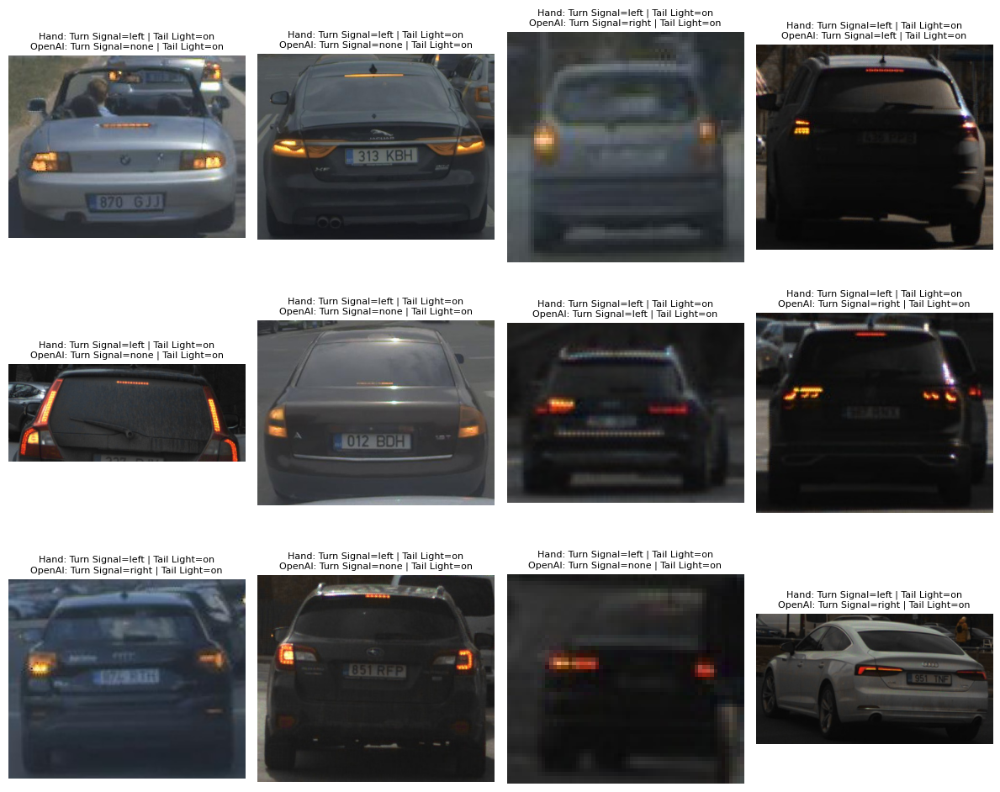

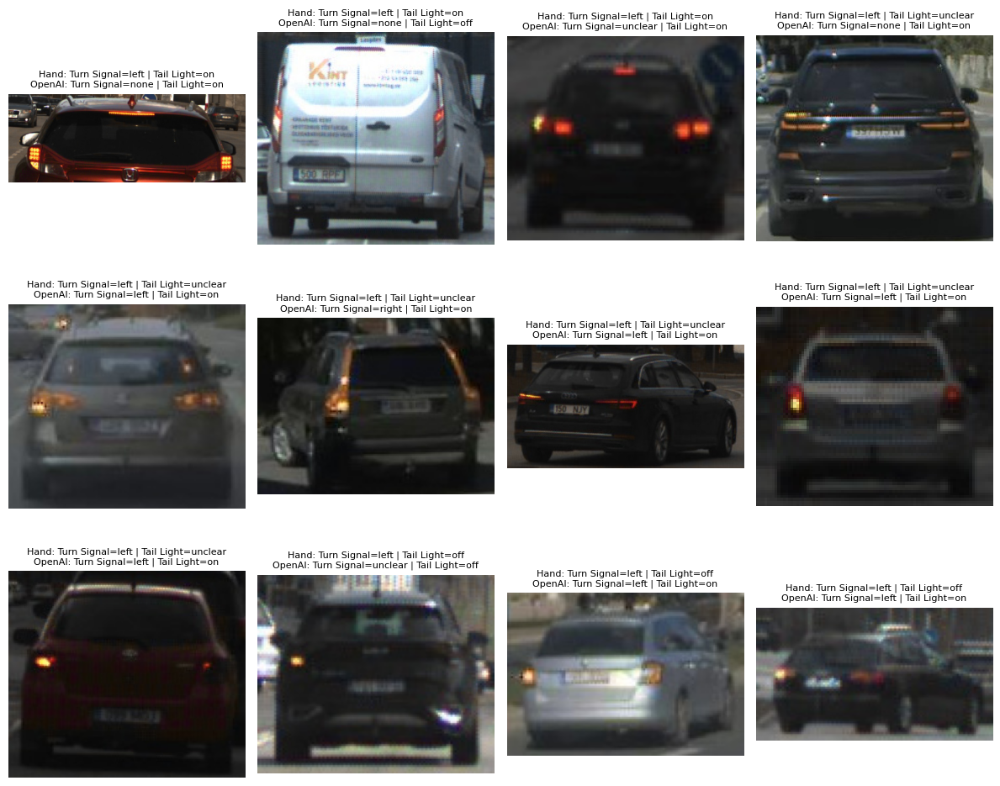

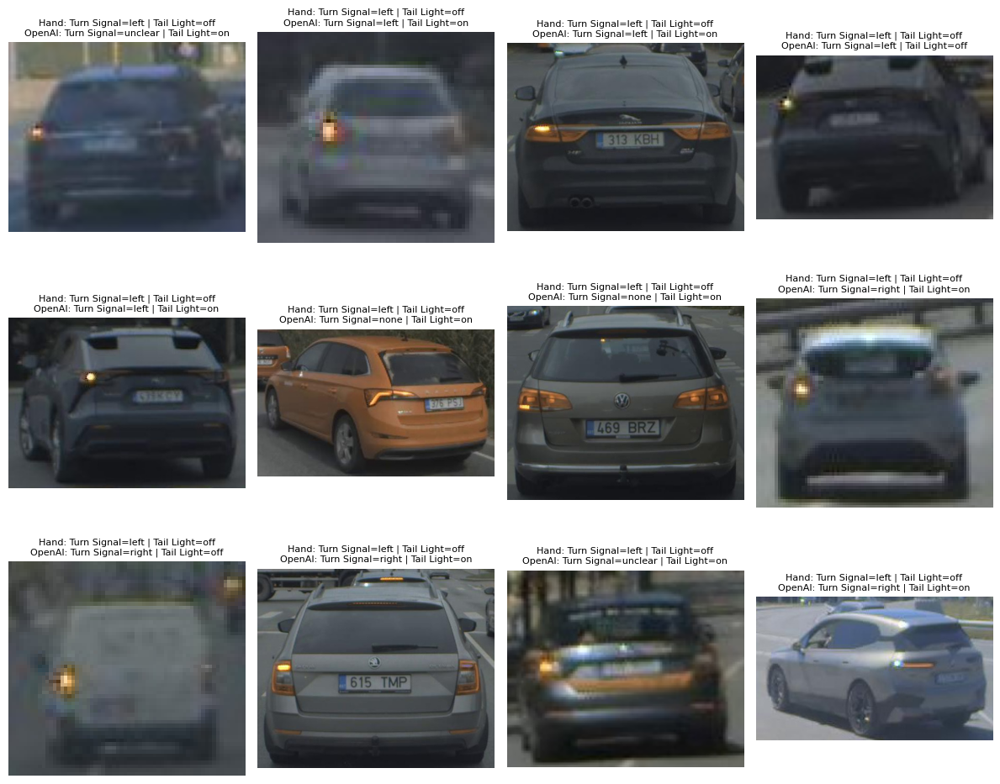

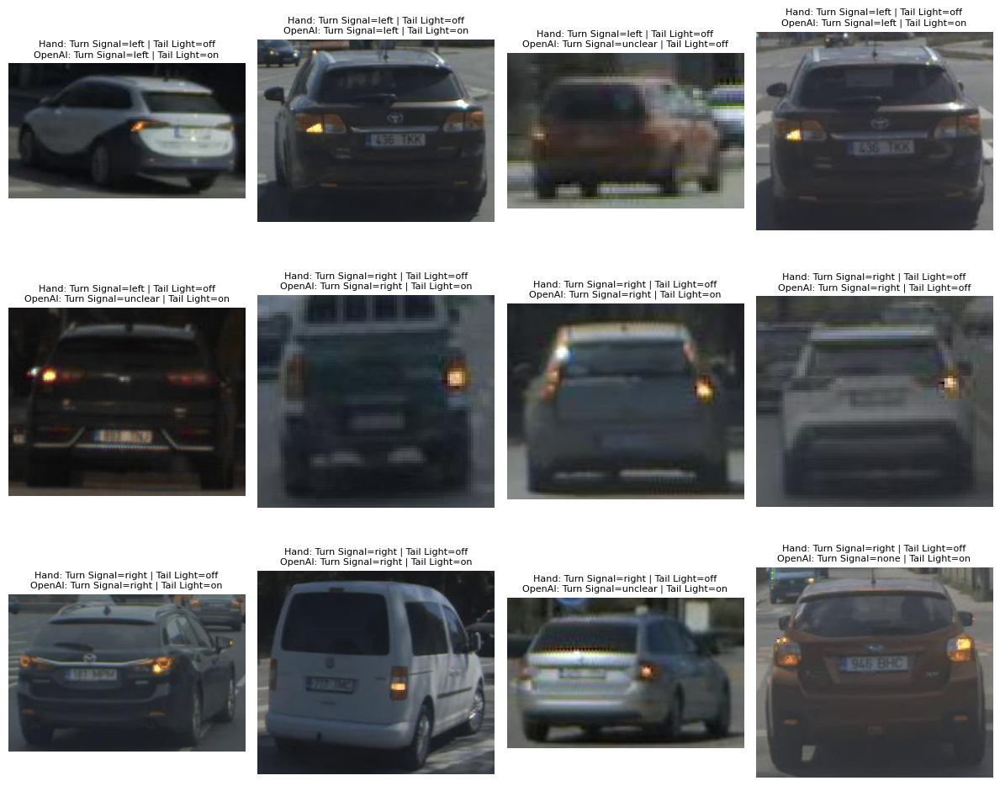

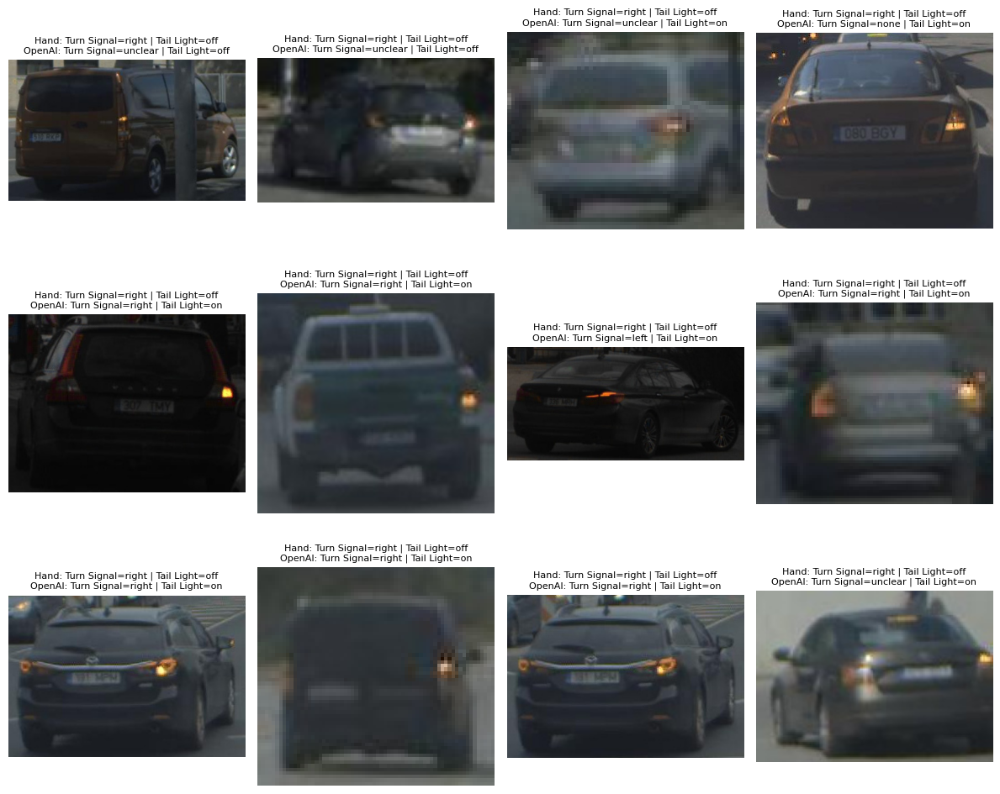

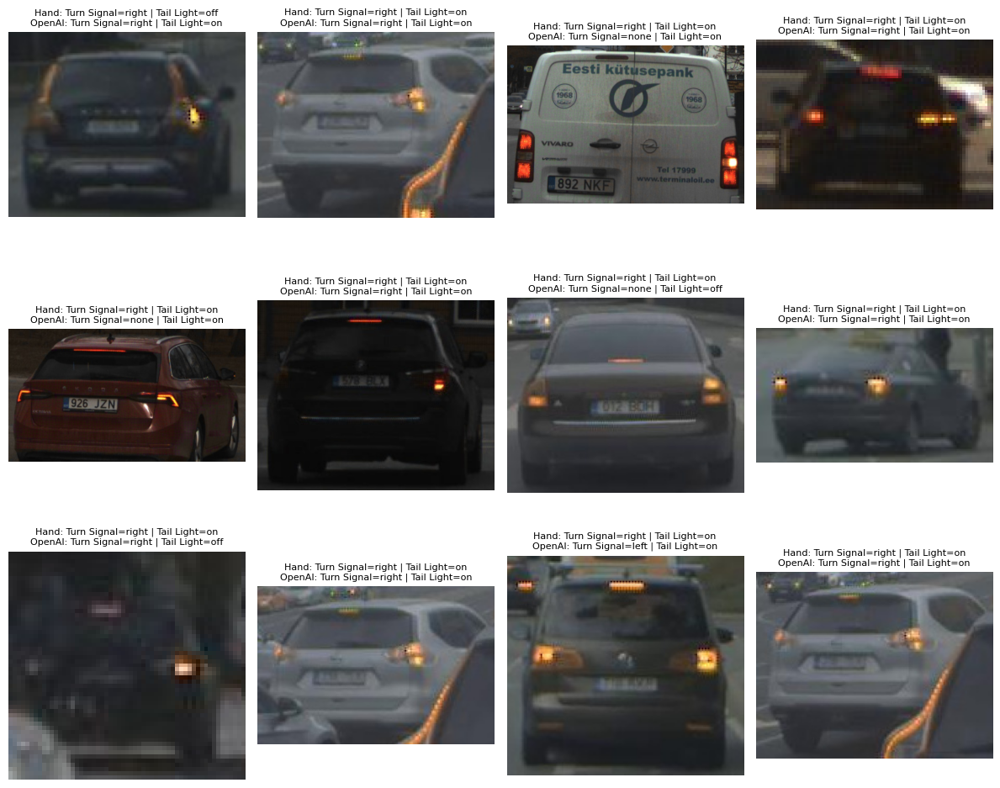

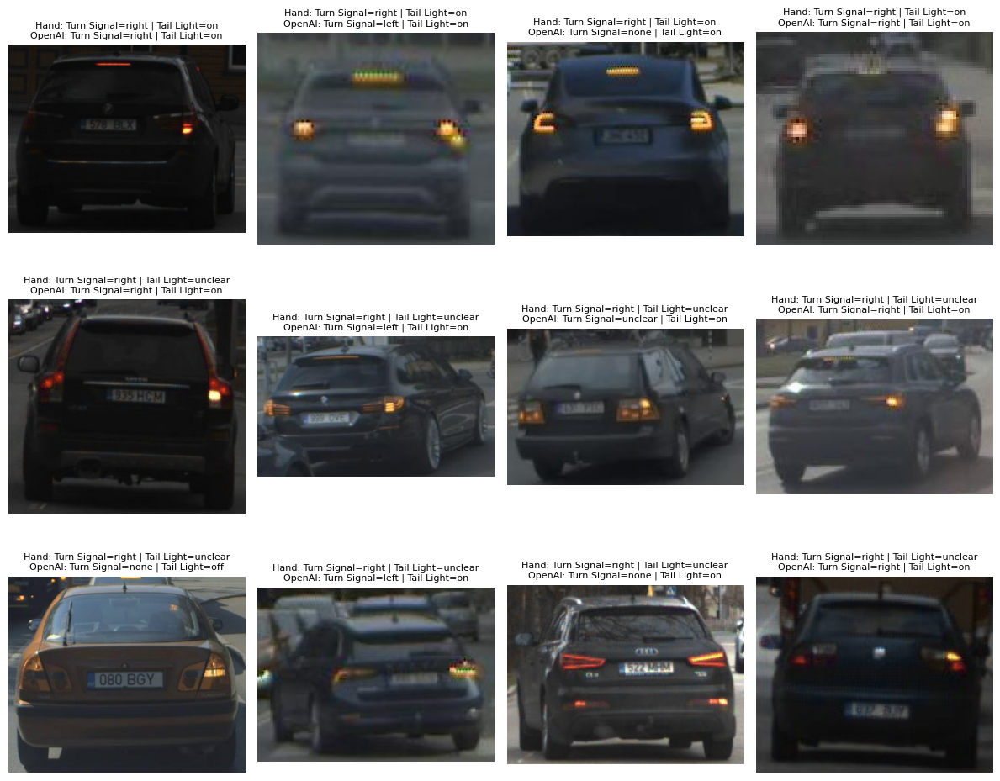

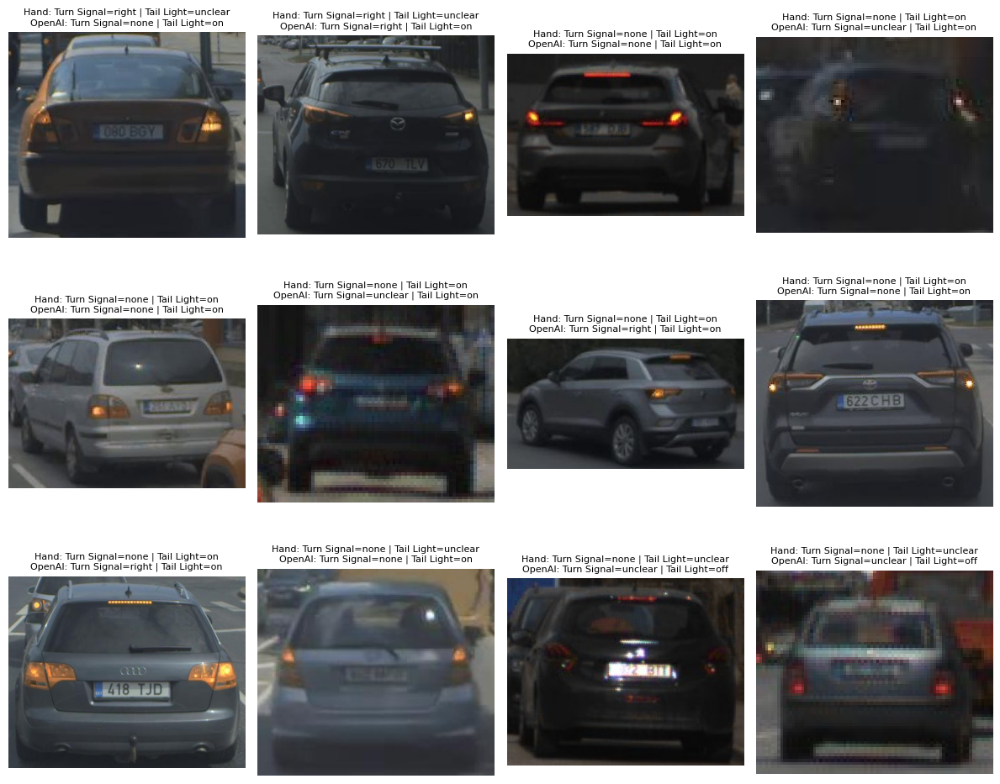

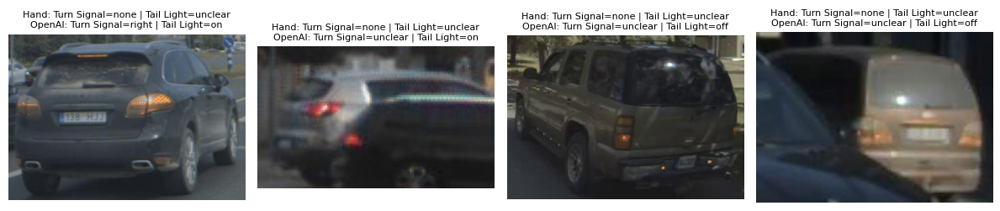

In [11]:
RESULTS_PATH = "../json_txt/gpt-4o-mini_prompt1.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [12]:
with open("../json_txt/gpt-4o-mini_prompt1.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 44.00%
Tail light accuracy: 41.00%


## gpt-4o & prompt 1

Ran approx: 7:47pm October 27 2025

In [13]:
OUTPUT_FILE = "../json_txt/gpt-4o_prompt1.json"

In [14]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none, both\n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [15]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [16]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/100 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:   1%|▏                      | 1/100 [00:01<02:42,  1.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:   2%|▍                      | 2/100 [00:06<05:42,  3.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0137653.jpg


Classifying images:   3%|▋                      | 3/100 [00:18<11:42,  7.24s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-09-54_mapping_tartu_streets/camera_fl/predict/crops/car/012056.jpg


Classifying images:   4%|▉                      | 4/100 [00:19<08:03,  5.03s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:   5%|█▏                     | 5/100 [00:50<22:43, 14.35s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:   6%|█▍                     | 6/100 [01:03<21:42, 13.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-37-46_mapping_tartu_streets/camera_fl/predict/crops/car/0628284.jpg


Classifying images:   7%|█▌                     | 7/100 [01:05<15:28,  9.98s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:   8%|█▊                     | 8/100 [01:07<11:22,  7.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:   9%|██                     | 9/100 [01:09<08:37,  5.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  10%|██▏                   | 10/100 [01:12<07:07,  4.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  11%|██▍                   | 11/100 [01:14<05:54,  3.98s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  12%|██▋                   | 12/100 [01:17<05:19,  3.63s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  13%|██▊                   | 13/100 [01:20<05:10,  3.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  14%|███                   | 14/100 [01:21<04:11,  2.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  15%|███▎                  | 15/100 [01:24<03:50,  2.72s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  16%|███▌                  | 16/100 [01:27<03:52,  2.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  17%|███▋                  | 17/100 [01:28<03:21,  2.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  18%|███▉                  | 18/100 [01:30<02:54,  2.13s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  19%|████▏                 | 19/100 [01:33<03:25,  2.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  20%|████▍                 | 20/100 [01:34<02:54,  2.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  21%|████▌                 | 21/100 [01:36<02:46,  2.11s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-35-00_mapping_tartu_streets/camera_fl/predict/crops/car/0381914.jpg


Classifying images:  22%|████▊                 | 22/100 [01:39<02:53,  2.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  23%|█████                 | 23/100 [01:40<02:31,  1.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  24%|█████▎                | 24/100 [01:43<02:48,  2.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0087872.jpg


Classifying images:  25%|█████▌                | 25/100 [01:45<02:35,  2.07s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  26%|█████▋                | 26/100 [01:46<02:23,  1.94s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  27%|█████▉                | 27/100 [01:48<02:08,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  28%|██████▏               | 28/100 [01:49<01:56,  1.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_narrow_front/predict/crops/car/034470.jpg


Classifying images:  29%|██████▍               | 29/100 [01:50<01:43,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  30%|██████▌               | 30/100 [01:52<02:01,  1.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0660002.jpg


Classifying images:  31%|██████▊               | 31/100 [01:54<02:03,  1.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  32%|███████               | 32/100 [01:56<01:54,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  33%|███████▎              | 33/100 [02:00<02:41,  2.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0189483.jpg


Classifying images:  34%|███████▍              | 34/100 [02:01<02:21,  2.15s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0817932.jpg


Classifying images:  35%|███████▋              | 35/100 [02:04<02:19,  2.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  36%|███████▉              | 36/100 [02:05<02:05,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  37%|████████▏             | 37/100 [02:07<01:53,  1.80s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  38%|████████▎             | 38/100 [02:09<01:57,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  39%|████████▌             | 39/100 [02:11<01:55,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  40%|████████▊             | 40/100 [02:12<01:45,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  41%|█████████             | 41/100 [02:14<01:50,  1.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_right/predict/crops/car/0587347.jpg


Classifying images:  42%|█████████▏            | 42/100 [02:16<01:56,  2.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  43%|█████████▍            | 43/100 [02:18<01:49,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  44%|█████████▋            | 44/100 [02:21<01:55,  2.06s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  45%|█████████▉            | 45/100 [02:30<03:55,  4.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  46%|██████████            | 46/100 [02:32<03:11,  3.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  47%|██████████▎           | 47/100 [02:33<02:34,  2.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  48%|██████████▌           | 48/100 [02:36<02:27,  2.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  49%|██████████▊           | 49/100 [02:38<02:17,  2.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/0168752.jpg


Classifying images:  50%|███████████           | 50/100 [02:41<02:12,  2.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  51%|███████████▏          | 51/100 [02:50<03:44,  4.58s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  52%|███████████▍          | 52/100 [02:52<02:58,  3.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  53%|███████████▋          | 53/100 [02:57<03:23,  4.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  54%|███████████▉          | 54/100 [02:59<02:47,  3.63s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  55%|████████████          | 55/100 [03:01<02:11,  2.93s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0174873.jpg


Classifying images:  56%|████████████▎         | 56/100 [03:02<01:51,  2.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  57%|████████████▌         | 57/100 [03:04<01:36,  2.24s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▊         | 58/100 [03:07<01:49,  2.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  59%|████████████▉         | 59/100 [03:09<01:37,  2.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  60%|█████████████▏        | 60/100 [03:12<01:35,  2.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  61%|█████████████▍        | 61/100 [03:30<04:37,  7.13s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  62%|█████████████▋        | 62/100 [03:32<03:35,  5.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  63%|█████████████▊        | 63/100 [03:34<02:46,  4.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-03-44_mapping_tartu_streets/camera_fl/predict/crops/car/00640512.jpg


Classifying images:  64%|██████████████        | 64/100 [03:36<02:16,  3.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  65%|██████████████▎       | 65/100 [03:49<03:54,  6.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457733.jpg


Classifying images:  66%|██████████████▌       | 66/100 [03:51<02:54,  5.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  67%|██████████████▋       | 67/100 [04:08<04:49,  8.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  68%|██████████████▉       | 68/100 [04:09<03:24,  6.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  69%|███████████████▏      | 69/100 [04:11<02:33,  4.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  70%|███████████████▍      | 70/100 [04:30<04:42,  9.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  71%|███████████████▌      | 71/100 [04:33<03:29,  7.24s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  72%|███████████████▊      | 72/100 [04:35<02:39,  5.70s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  73%|████████████████      | 73/100 [04:40<02:31,  5.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0170983.jpg


Classifying images:  74%|████████████████▎     | 74/100 [04:42<01:56,  4.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  75%|████████████████▌     | 75/100 [04:44<01:37,  3.91s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  76%|████████████████▋     | 76/100 [04:46<01:18,  3.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  77%|████████████████▉     | 77/100 [04:48<01:05,  2.87s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  78%|█████████████████▏    | 78/100 [04:50<00:57,  2.62s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  79%|█████████████████▍    | 79/100 [04:52<00:47,  2.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  80%|█████████████████▌    | 80/100 [04:53<00:41,  2.07s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  81%|█████████████████▊    | 81/100 [05:22<03:13, 10.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|██████████████████    | 82/100 [05:25<02:21,  7.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  83%|██████████████████▎   | 83/100 [05:28<01:48,  6.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  84%|██████████████████▍   | 84/100 [05:30<01:19,  4.99s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  85%|██████████████████▋   | 85/100 [05:32<01:04,  4.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████▉   | 86/100 [05:34<00:50,  3.63s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-18-40_mapping_tartu_streets/camera_fl/predict/crops/car/0545602.jpg


Classifying images:  87%|███████████████████▏  | 87/100 [05:40<00:56,  4.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1186544.jpg


Classifying images:  88%|███████████████████▎  | 88/100 [05:43<00:45,  3.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0229413.jpg


Classifying images:  89%|███████████████████▌  | 89/100 [05:44<00:33,  3.08s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-46-34_mapping_tartu_streets/camera_fl/predict/crops/car/0434254.jpg


Classifying images:  90%|███████████████████▊  | 90/100 [05:46<00:25,  2.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_left/predict/crops/car/068826.jpg


Classifying images:  91%|████████████████████  | 91/100 [05:48<00:22,  2.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-55-12_mapping_tartu_streets/camera_wide_front/predict/crops/car/038820.jpg


Classifying images:  92%|████████████████████▏ | 92/100 [05:50<00:19,  2.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0297162.jpg


Classifying images:  93%|████████████████████▍ | 93/100 [05:53<00:18,  2.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-39-36_mapping_tartu_streets/camera_wide_front/predict/crops/car/027909.jpg


Classifying images:  94%|████████████████████▋ | 94/100 [05:55<00:13,  2.24s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-00-07_mapping_tartu_streets/camera_fl/predict/crops/car/015264.jpg


Classifying images:  95%|████████████████████▉ | 95/100 [05:56<00:10,  2.08s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/029027.jpg


Classifying images:  96%|█████████████████████ | 96/100 [05:58<00:07,  1.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0295092.jpg


Classifying images:  97%|█████████████████████▎| 97/100 [06:00<00:06,  2.07s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0266875.jpg


Classifying images:  98%|█████████████████████▌| 98/100 [06:03<00:04,  2.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/034182.jpg


Classifying images:  99%|█████████████████████▊| 99/100 [06:06<00:02,  2.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_back/predict/crops/car/0045493.jpg


Classifying images: 100%|█████████████████████| 100/100 [06:28<00:00,  3.88s/it]


Done! Saved 100 results to ../json_txt/gpt-4o_prompt1.json


### Display results side-by-side

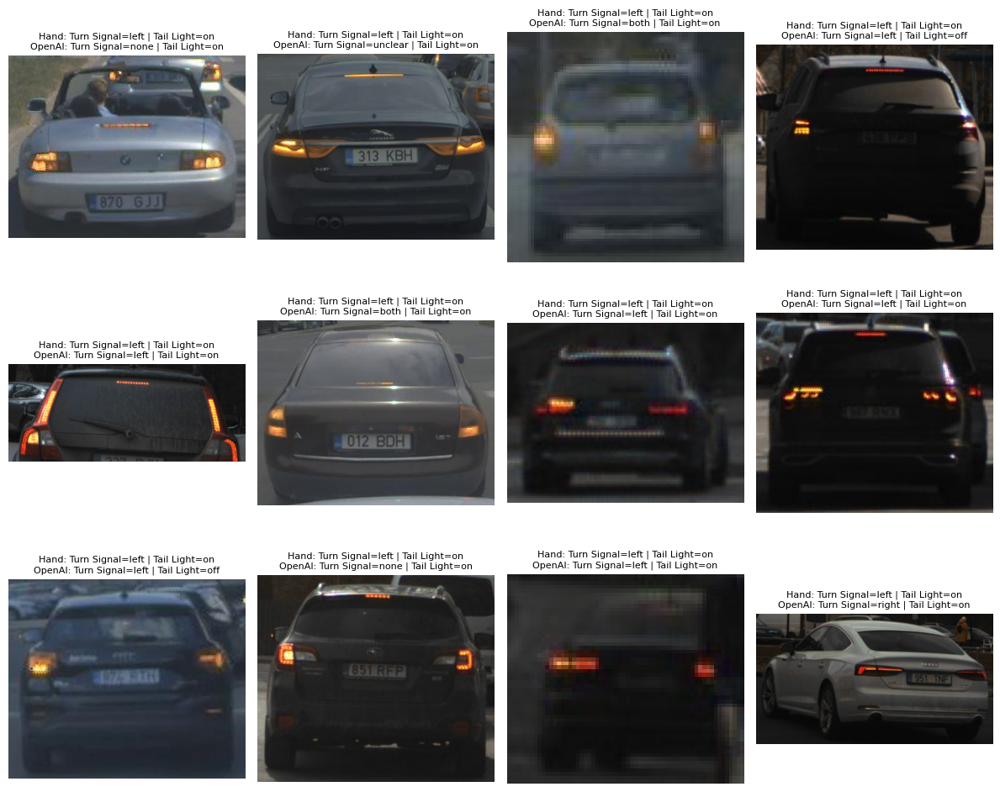

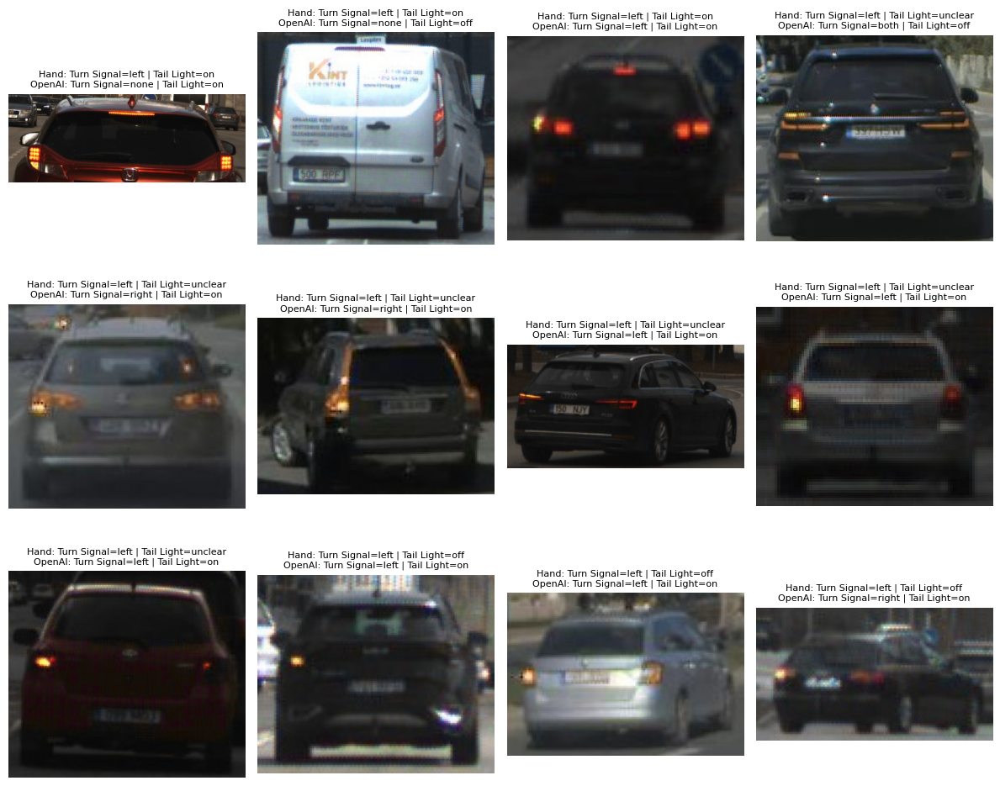

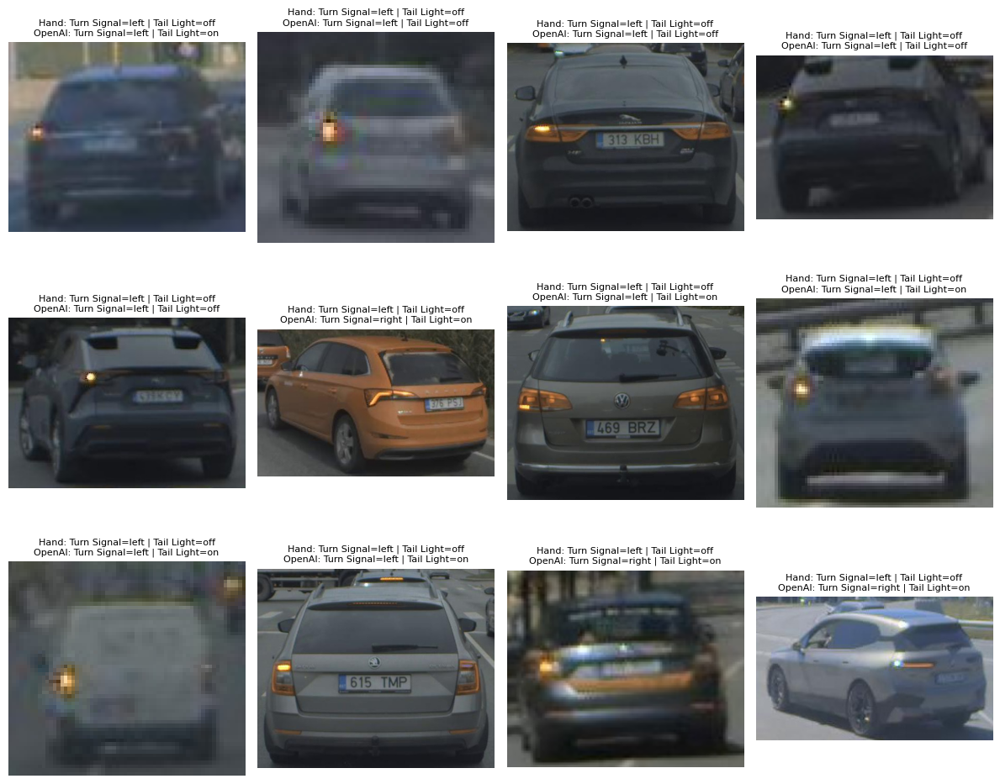

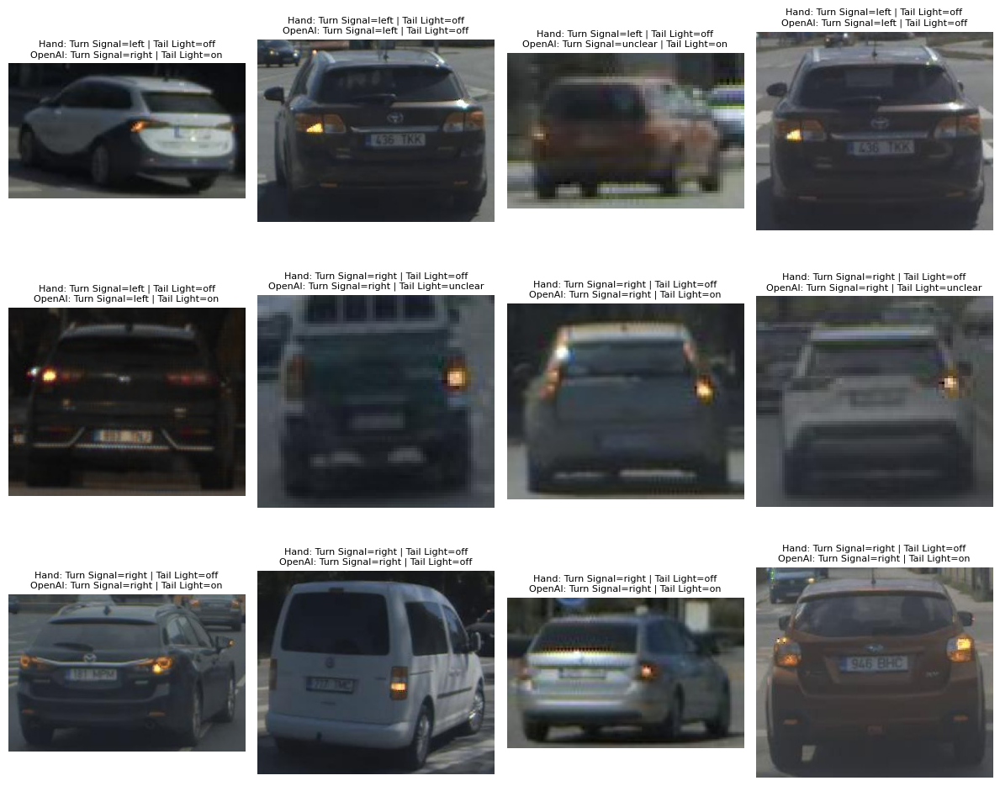

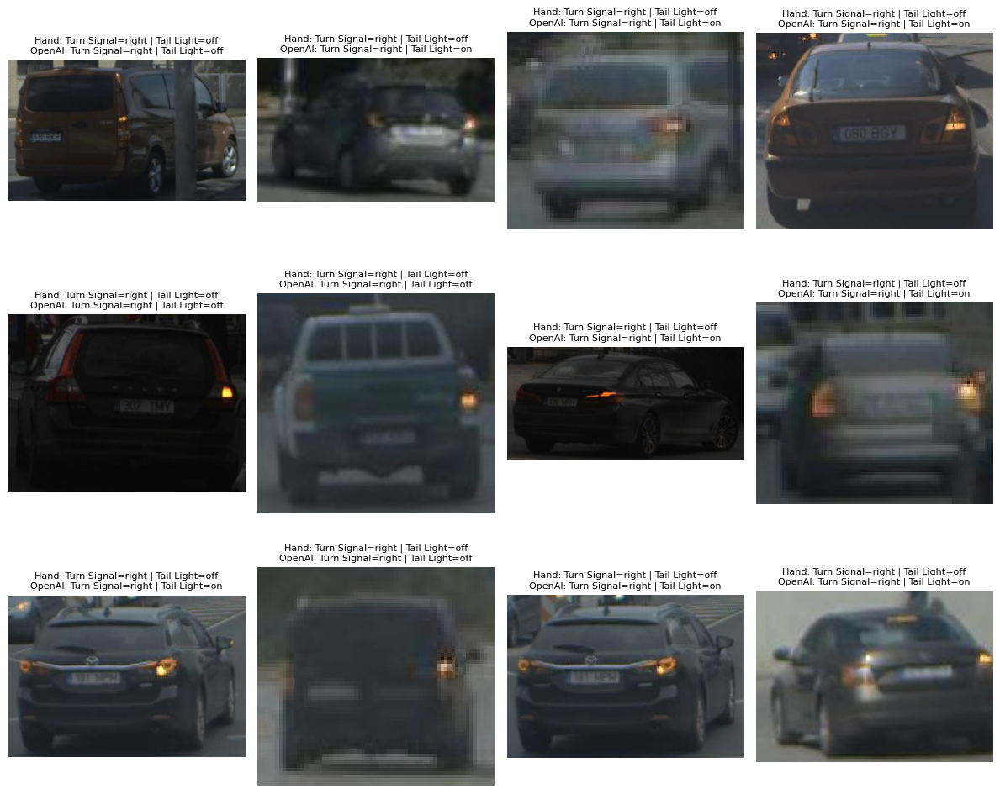

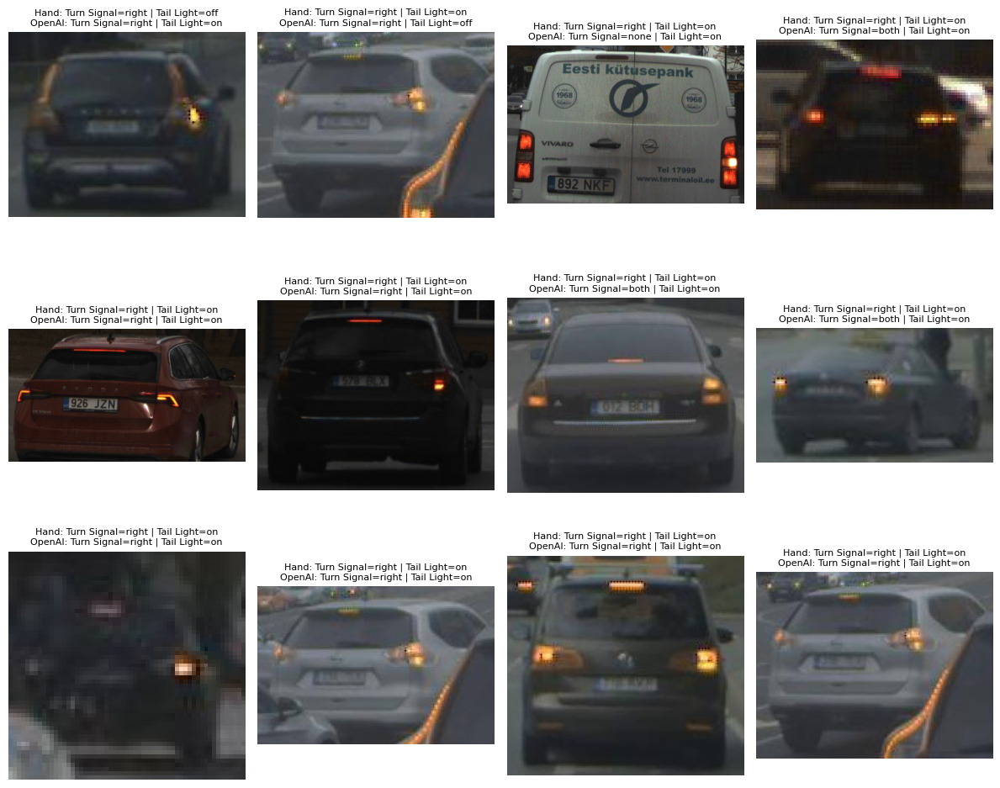

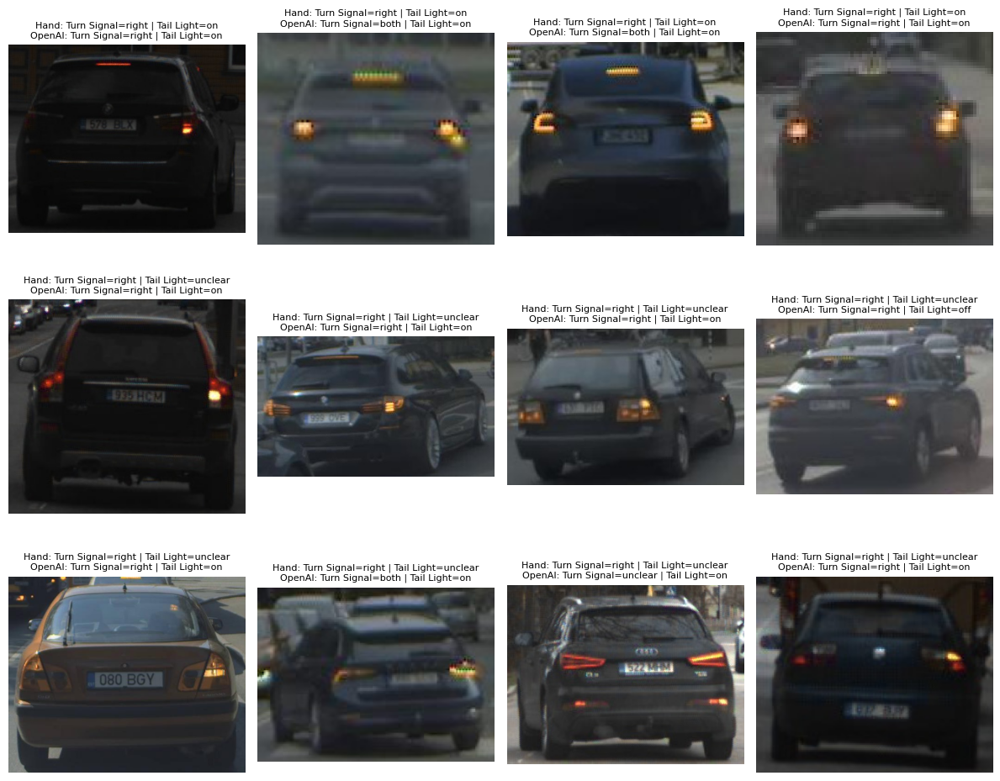

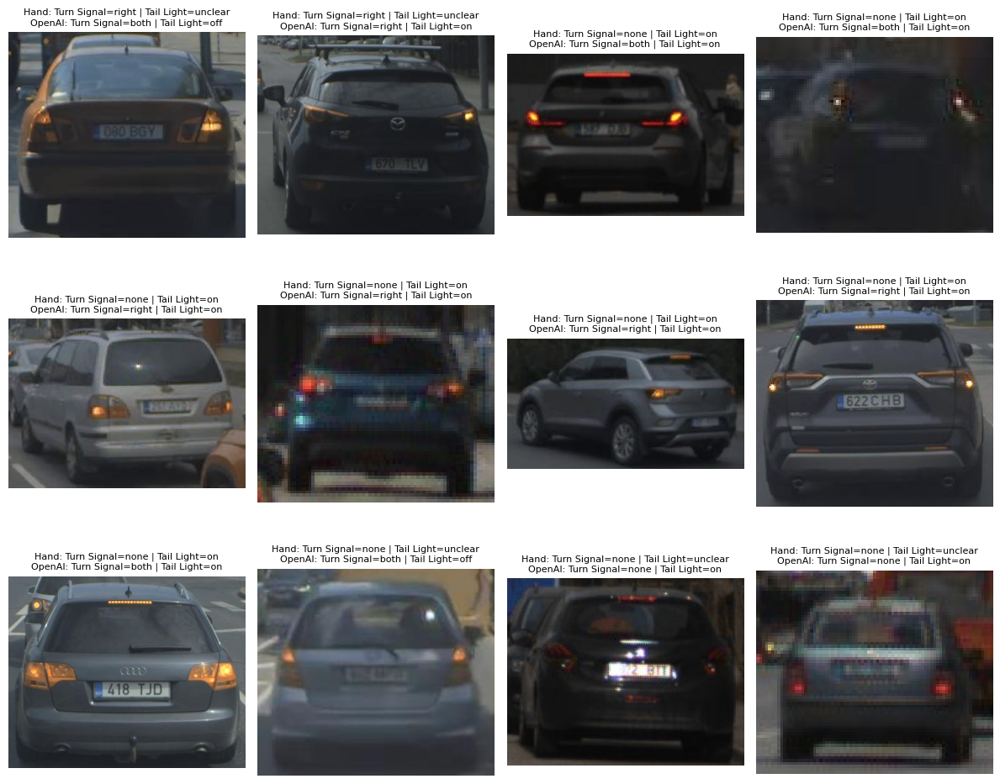

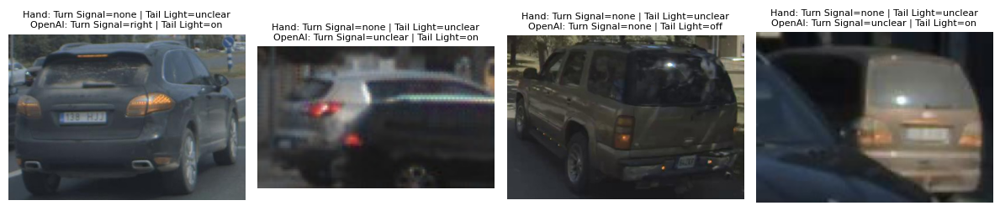

In [17]:
RESULTS_PATH = "../json_txt/gpt-4o_prompt1.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [18]:
with open("../json_txt/gpt-4o_prompt1.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 63.00%
Tail light accuracy: 44.00%


## gpt-4o-mini & prompt 2

Prompt 1:

```
"You are an advanced image analysis model. Look at the car image and determine:\n"
"1. turn_signal — one of: left, right, unclear, none \n"
"2. tail_light — one of: on, off, unclear \n\n"
"Return only valid JSON in this format:\n"
"{\n"
"  \"turn_signal\": \"left\",\n"
"  \"tail_light\": \"on\"\n"
"}"
```

Removing the none and both options, as perhaps this "confuses" the model.

Running at approx 7:54pm October 27, 2025

In [19]:
OUTPUT_FILE = "../json_txt/gpt-4o-mini_prompt2.json"

In [20]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none \n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o-mini",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [21]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [22]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/100 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:   1%|▏                      | 1/100 [00:01<02:01,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:   2%|▍                      | 2/100 [00:03<03:23,  2.08s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0137653.jpg


Classifying images:   3%|▋                      | 3/100 [00:05<02:50,  1.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-09-54_mapping_tartu_streets/camera_fl/predict/crops/car/012056.jpg


Classifying images:   4%|▉                      | 4/100 [00:10<04:47,  3.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:   5%|█▏                     | 5/100 [00:11<03:49,  2.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:   6%|█▍                     | 6/100 [00:12<03:04,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-37-46_mapping_tartu_streets/camera_fl/predict/crops/car/0628284.jpg


Classifying images:   7%|█▌                     | 7/100 [00:14<02:55,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:   8%|█▊                     | 8/100 [00:15<02:35,  1.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:   9%|██                     | 9/100 [00:16<02:18,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  10%|██▏                   | 10/100 [00:19<02:38,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  11%|██▍                   | 11/100 [00:20<02:21,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  12%|██▋                   | 12/100 [00:21<02:20,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  13%|██▊                   | 13/100 [00:23<02:08,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  14%|███                   | 14/100 [00:24<02:09,  1.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  15%|███▎                  | 15/100 [00:26<02:04,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  16%|███▌                  | 16/100 [00:27<01:51,  1.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  17%|███▋                  | 17/100 [00:28<01:46,  1.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  18%|███▉                  | 18/100 [00:30<02:05,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  19%|████▏                 | 19/100 [00:31<02:03,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  20%|████▍                 | 20/100 [00:35<02:41,  2.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  21%|████▌                 | 21/100 [00:36<02:30,  1.90s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-35-00_mapping_tartu_streets/camera_fl/predict/crops/car/0381914.jpg


Classifying images:  22%|████▊                 | 22/100 [00:37<02:15,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  23%|█████                 | 23/100 [00:38<01:54,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  24%|█████▎                | 24/100 [00:40<01:51,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0087872.jpg


Classifying images:  25%|█████▌                | 25/100 [00:41<01:37,  1.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  26%|█████▋                | 26/100 [00:42<01:26,  1.16s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  27%|█████▉                | 27/100 [00:43<01:34,  1.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  28%|██████▏               | 28/100 [00:45<01:36,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_narrow_front/predict/crops/car/034470.jpg


Classifying images:  29%|██████▍               | 29/100 [00:46<01:30,  1.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  30%|██████▌               | 30/100 [00:47<01:25,  1.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0660002.jpg


Classifying images:  31%|██████▊               | 31/100 [00:48<01:17,  1.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  32%|███████               | 32/100 [00:49<01:11,  1.05s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  33%|███████▎              | 33/100 [00:50<01:09,  1.04s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0189483.jpg


Classifying images:  34%|███████▍              | 34/100 [00:52<01:33,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0817932.jpg


Classifying images:  35%|███████▋              | 35/100 [00:54<01:38,  1.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  36%|███████▉              | 36/100 [00:55<01:31,  1.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  37%|████████▏             | 37/100 [00:56<01:26,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  38%|████████▎             | 38/100 [00:58<01:28,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  39%|████████▌             | 39/100 [00:58<01:14,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  40%|████████▊             | 40/100 [01:00<01:18,  1.31s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  41%|█████████             | 41/100 [01:03<01:39,  1.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_right/predict/crops/car/0587347.jpg


Classifying images:  42%|█████████▏            | 42/100 [01:04<01:42,  1.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  43%|█████████▍            | 43/100 [01:06<01:35,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  44%|█████████▋            | 44/100 [01:07<01:29,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  45%|█████████▉            | 45/100 [01:10<01:46,  1.94s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  46%|██████████            | 46/100 [01:11<01:33,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  47%|██████████▎           | 47/100 [01:12<01:20,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  48%|██████████▌           | 48/100 [01:14<01:16,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  49%|██████████▊           | 49/100 [01:15<01:14,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/0168752.jpg


Classifying images:  50%|███████████           | 50/100 [01:17<01:12,  1.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  51%|███████████▏          | 51/100 [01:19<01:21,  1.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  52%|███████████▍          | 52/100 [01:20<01:20,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  53%|███████████▋          | 53/100 [01:22<01:17,  1.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  54%|███████████▉          | 54/100 [01:24<01:16,  1.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  55%|████████████          | 55/100 [01:26<01:19,  1.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0174873.jpg


Classifying images:  56%|████████████▎         | 56/100 [01:28<01:26,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  57%|████████████▌         | 57/100 [01:29<01:11,  1.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▊         | 58/100 [01:31<01:06,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  59%|████████████▉         | 59/100 [01:31<00:56,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  60%|█████████████▏        | 60/100 [01:33<00:58,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  61%|█████████████▍        | 61/100 [01:34<00:55,  1.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  62%|█████████████▋        | 62/100 [01:36<00:57,  1.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  63%|█████████████▊        | 63/100 [01:38<01:02,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-03-44_mapping_tartu_streets/camera_fl/predict/crops/car/00640512.jpg


Classifying images:  64%|██████████████        | 64/100 [01:39<00:55,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  65%|██████████████▎       | 65/100 [01:41<00:54,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457733.jpg


Classifying images:  66%|██████████████▌       | 66/100 [01:43<00:53,  1.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  67%|██████████████▋       | 67/100 [01:44<00:47,  1.45s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  68%|██████████████▉       | 68/100 [01:45<00:45,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  69%|███████████████▏      | 69/100 [01:46<00:37,  1.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  70%|███████████████▍      | 70/100 [01:47<00:39,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  71%|███████████████▌      | 71/100 [01:49<00:36,  1.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  72%|███████████████▊      | 72/100 [01:49<00:31,  1.13s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  73%|████████████████      | 73/100 [01:51<00:34,  1.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0170983.jpg


Classifying images:  74%|████████████████▎     | 74/100 [01:52<00:32,  1.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  75%|████████████████▌     | 75/100 [01:54<00:37,  1.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  76%|████████████████▋     | 76/100 [01:55<00:33,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  77%|████████████████▉     | 77/100 [01:57<00:30,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  78%|█████████████████▏    | 78/100 [02:00<00:40,  1.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  79%|█████████████████▍    | 79/100 [02:02<00:41,  1.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  80%|█████████████████▌    | 80/100 [02:03<00:33,  1.70s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  81%|█████████████████▊    | 81/100 [02:04<00:29,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|██████████████████    | 82/100 [02:06<00:27,  1.55s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  83%|██████████████████▎   | 83/100 [02:07<00:27,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  84%|██████████████████▍   | 84/100 [02:09<00:24,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  85%|██████████████████▋   | 85/100 [02:10<00:22,  1.48s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████▉   | 86/100 [02:12<00:20,  1.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-18-40_mapping_tartu_streets/camera_fl/predict/crops/car/0545602.jpg


Classifying images:  87%|███████████████████▏  | 87/100 [02:13<00:17,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1186544.jpg


Classifying images:  88%|███████████████████▎  | 88/100 [02:14<00:16,  1.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0229413.jpg


Classifying images:  89%|███████████████████▌  | 89/100 [02:15<00:14,  1.35s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-46-34_mapping_tartu_streets/camera_fl/predict/crops/car/0434254.jpg


Classifying images:  90%|███████████████████▊  | 90/100 [02:17<00:13,  1.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_left/predict/crops/car/068826.jpg


Classifying images:  91%|████████████████████  | 91/100 [02:19<00:13,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-55-12_mapping_tartu_streets/camera_wide_front/predict/crops/car/038820.jpg


Classifying images:  92%|████████████████████▏ | 92/100 [02:21<00:13,  1.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0297162.jpg


Classifying images:  93%|████████████████████▍ | 93/100 [02:22<00:11,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-39-36_mapping_tartu_streets/camera_wide_front/predict/crops/car/027909.jpg


Classifying images:  94%|████████████████████▋ | 94/100 [02:23<00:08,  1.48s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-00-07_mapping_tartu_streets/camera_fl/predict/crops/car/015264.jpg


Classifying images:  95%|████████████████████▉ | 95/100 [02:24<00:06,  1.31s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/029027.jpg


Classifying images:  96%|█████████████████████ | 96/100 [02:26<00:05,  1.36s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0295092.jpg


Classifying images:  97%|█████████████████████▎| 97/100 [02:27<00:03,  1.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0266875.jpg


Classifying images:  98%|█████████████████████▌| 98/100 [02:28<00:02,  1.20s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/034182.jpg


Classifying images:  99%|█████████████████████▊| 99/100 [02:30<00:01,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_back/predict/crops/car/0045493.jpg


Classifying images: 100%|█████████████████████| 100/100 [02:31<00:00,  1.52s/it]


Done! Saved 100 results to ../json_txt/gpt-4o-mini_prompt2.json


### Display results side-by-side

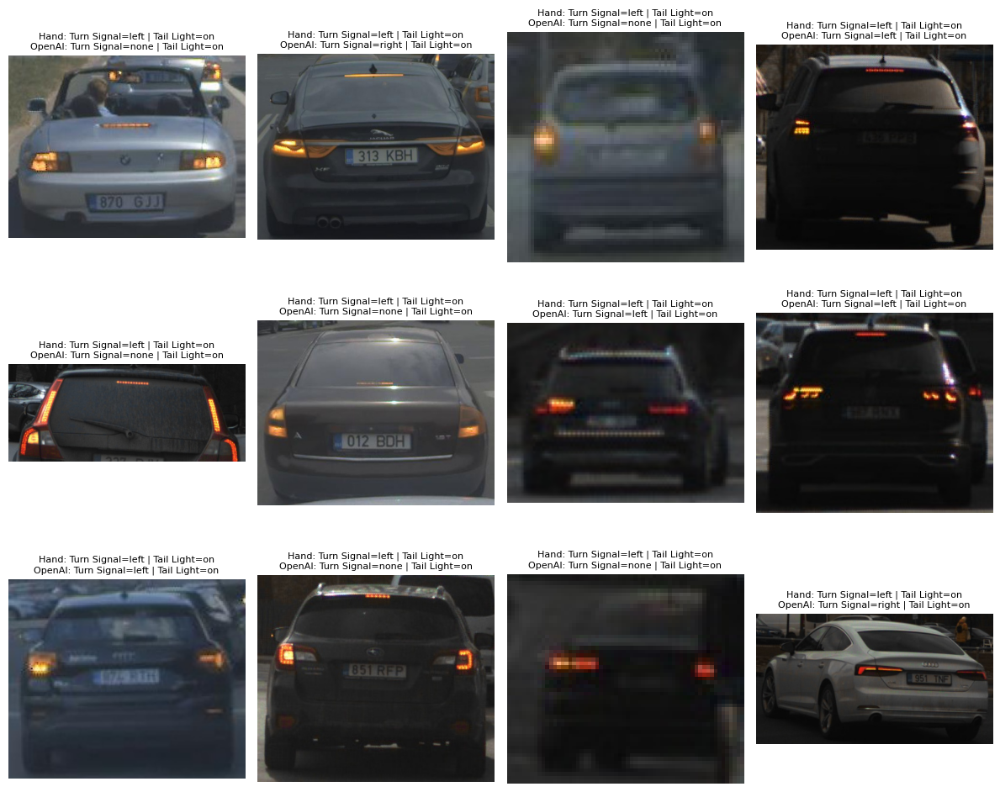

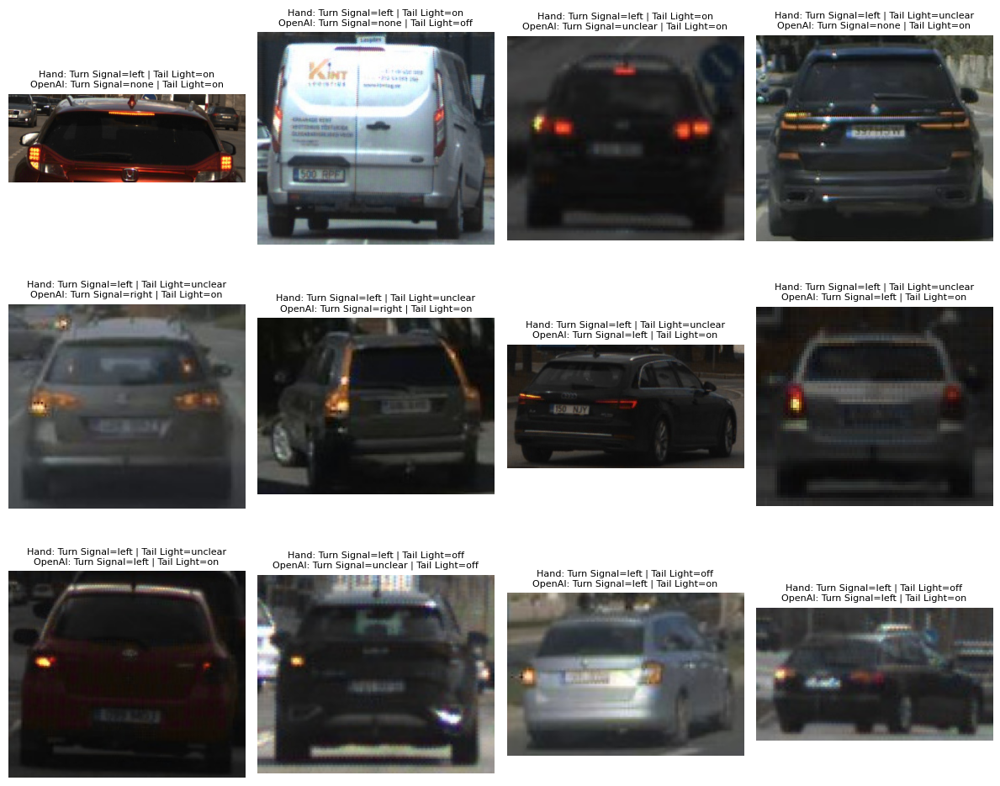

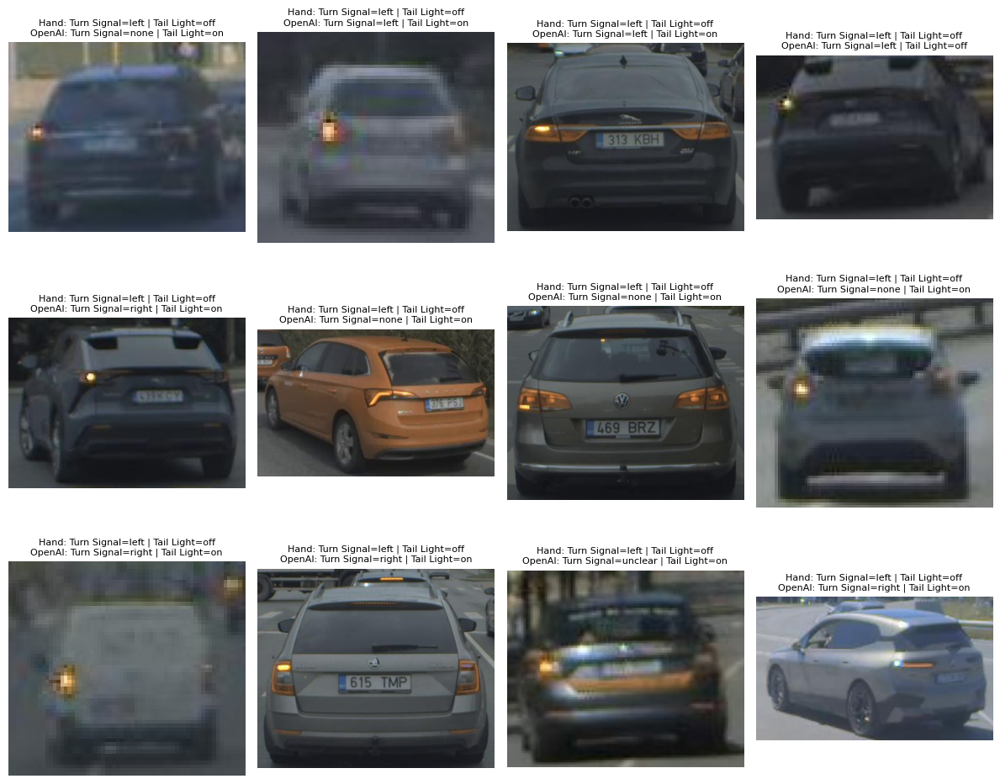

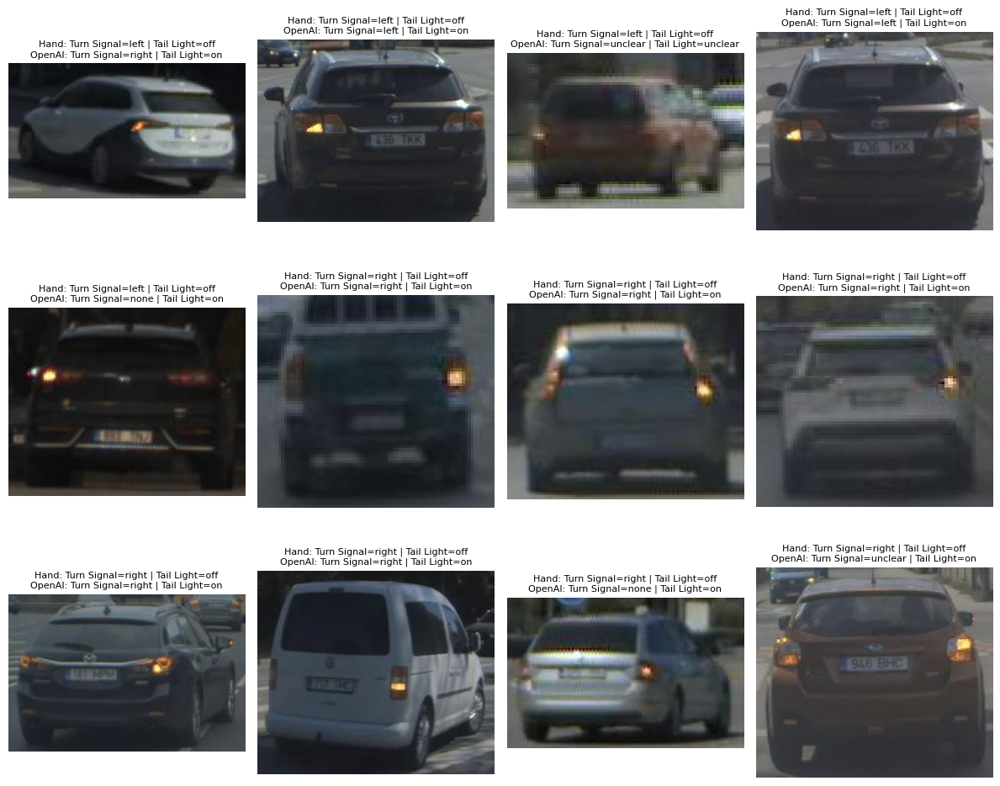

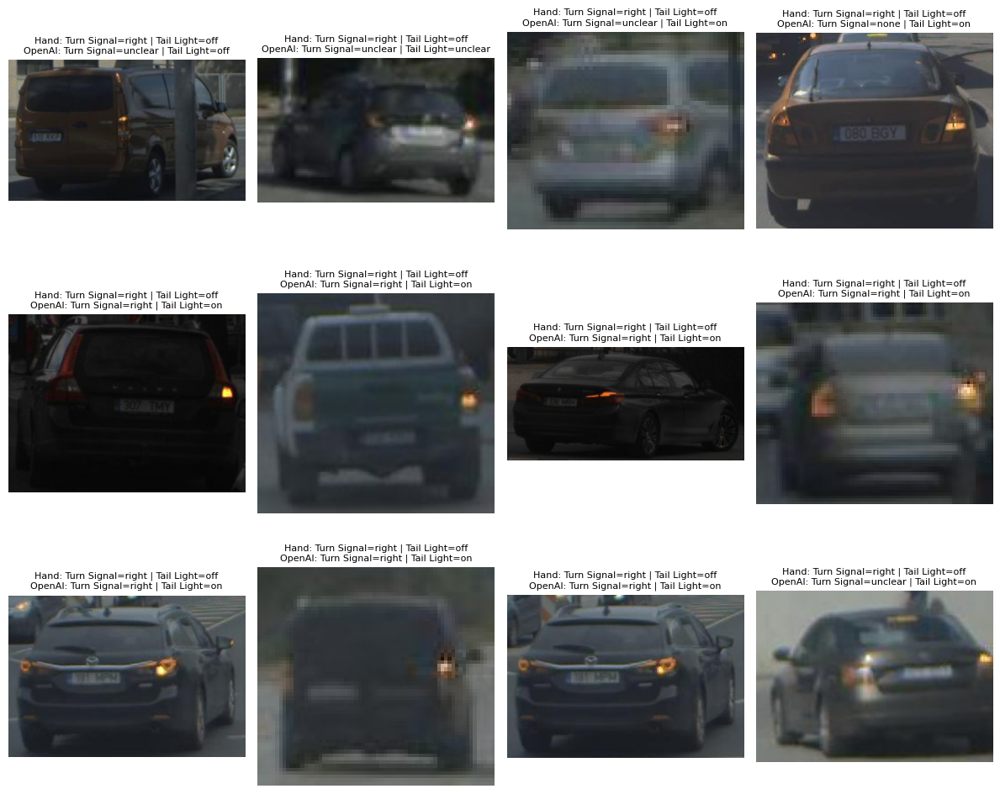

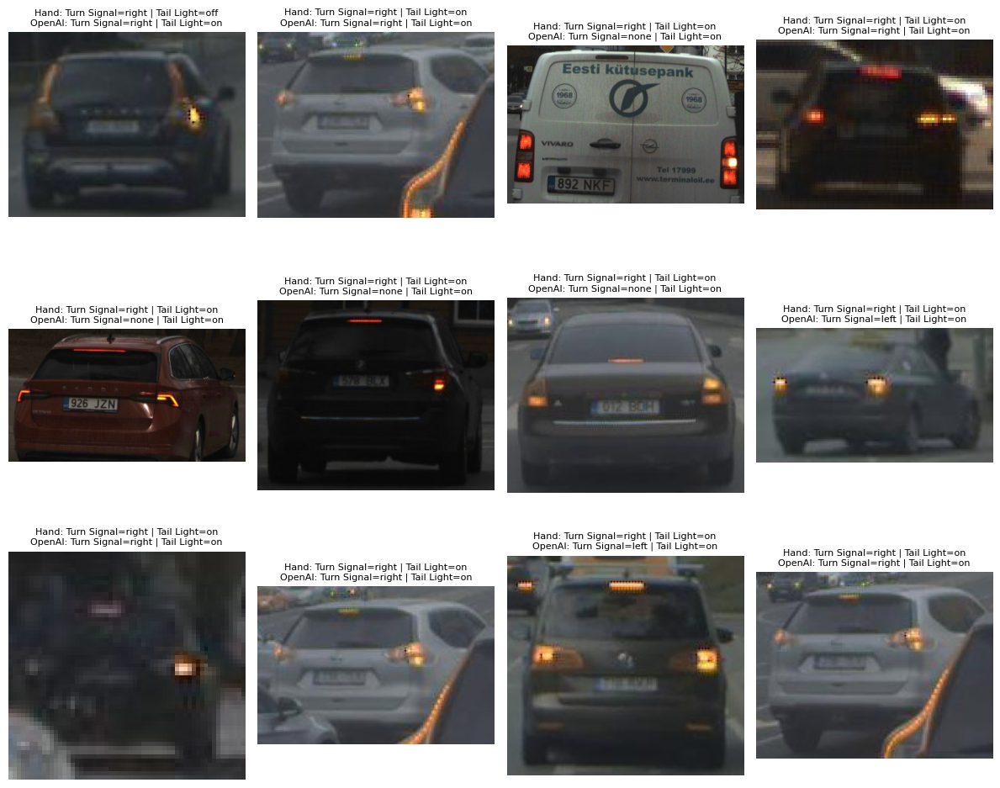

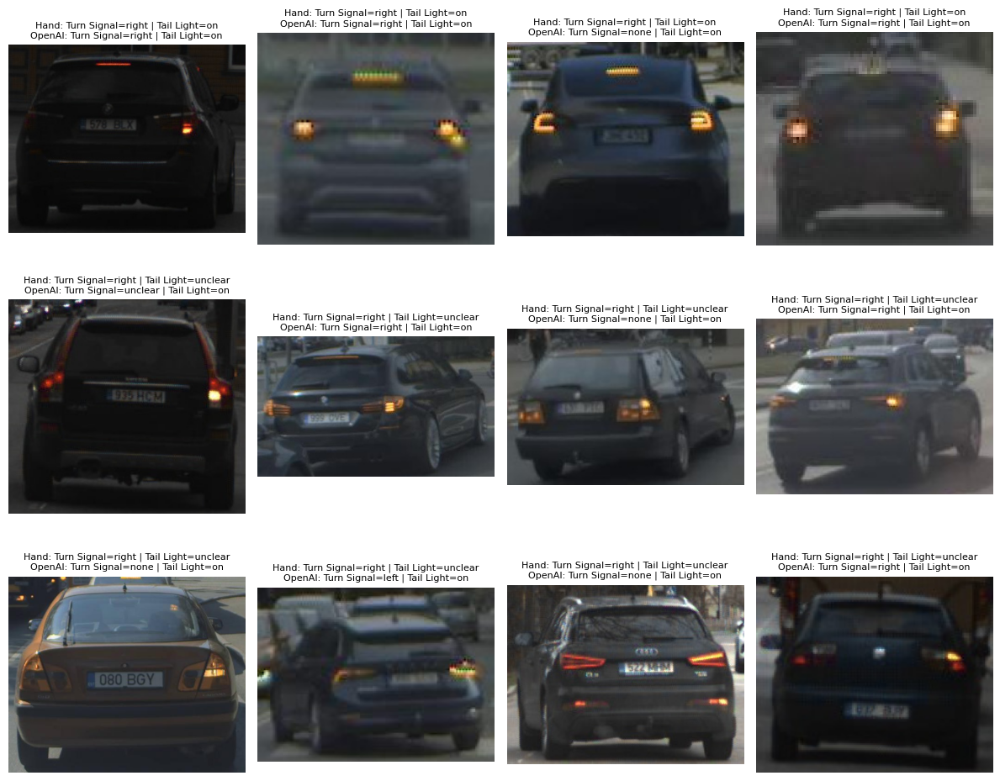

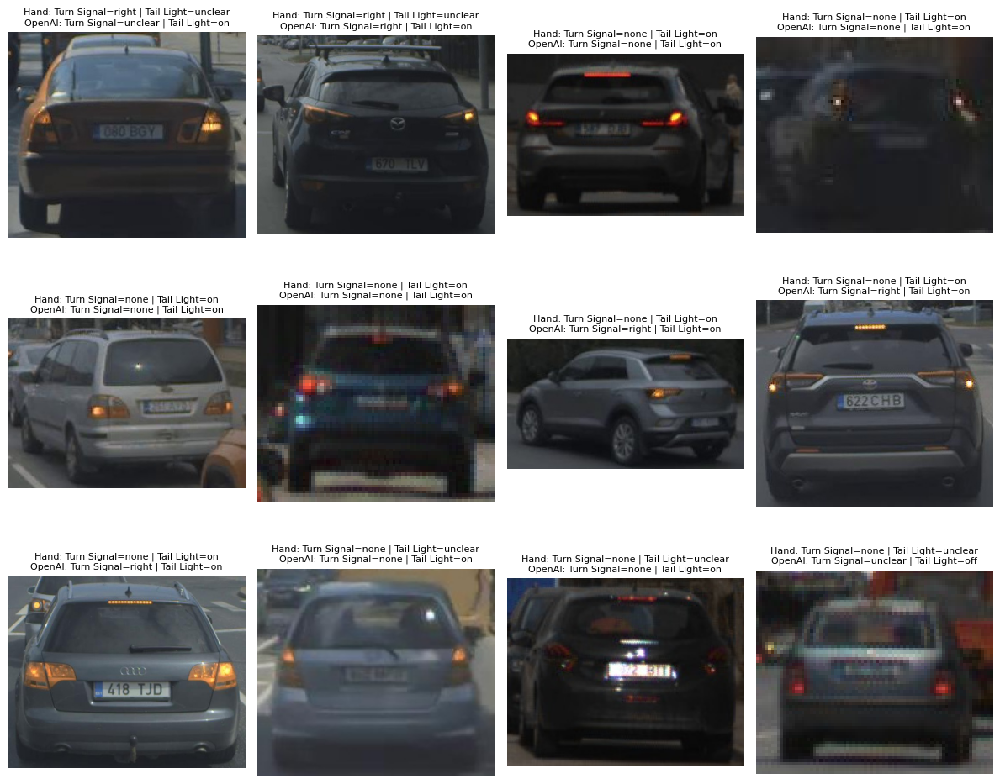

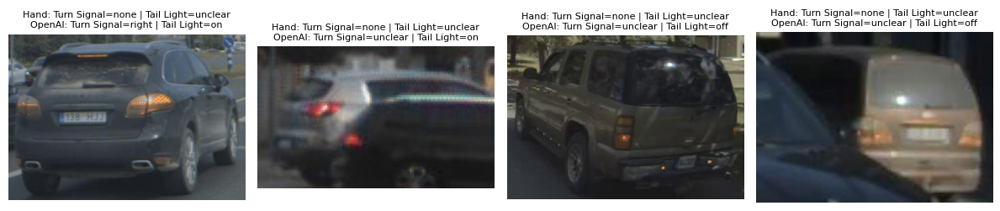

In [23]:
RESULTS_PATH = "../json_txt/gpt-4o-mini_prompt2.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [24]:
with open("../json_txt/gpt-4o-mini_prompt2.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 45.00%
Tail light accuracy: 39.00%


## gpt-4o & prompt 2

Running at approx 7:56pm, October 27, 2025

In [25]:
OUTPUT_FILE = "../json_txt/gpt-4o_prompt2.json"

In [26]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none \n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [27]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [28]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/100 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:   1%|▏                      | 1/100 [00:05<09:40,  5.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:   2%|▍                      | 2/100 [00:07<05:58,  3.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0137653.jpg


Classifying images:   3%|▋                      | 3/100 [00:09<04:36,  2.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-09-54_mapping_tartu_streets/camera_fl/predict/crops/car/012056.jpg


Classifying images:   4%|▉                      | 4/100 [00:11<03:44,  2.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:   5%|█▏                     | 5/100 [00:13<03:20,  2.11s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:   6%|█▍                     | 6/100 [00:14<03:05,  1.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-37-46_mapping_tartu_streets/camera_fl/predict/crops/car/0628284.jpg


Classifying images:   7%|█▌                     | 7/100 [00:36<12:59,  8.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:   8%|█▊                     | 8/100 [00:38<09:44,  6.35s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:   9%|██                     | 9/100 [01:06<19:53, 13.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  10%|██▏                   | 10/100 [01:08<14:31,  9.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  11%|██▍                   | 11/100 [01:11<11:17,  7.62s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  12%|██▋                   | 12/100 [01:19<11:12,  7.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  13%|██▊                   | 13/100 [01:20<08:31,  5.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  14%|███                   | 14/100 [01:22<06:38,  4.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  15%|███▎                  | 15/100 [01:24<05:28,  3.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  16%|███▌                  | 16/100 [01:26<04:35,  3.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  17%|███▋                  | 17/100 [01:27<03:40,  2.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  18%|███▉                  | 18/100 [01:28<02:59,  2.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  19%|████▏                 | 19/100 [01:30<02:39,  1.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  20%|████▍                 | 20/100 [01:32<02:29,  1.87s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  21%|████▌                 | 21/100 [01:32<02:06,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-35-00_mapping_tartu_streets/camera_fl/predict/crops/car/0381914.jpg


Classifying images:  22%|████▊                 | 22/100 [01:34<02:04,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  23%|█████                 | 23/100 [01:37<02:25,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  24%|█████▎                | 24/100 [01:39<02:31,  2.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0087872.jpg


Classifying images:  25%|█████▌                | 25/100 [01:41<02:28,  1.98s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  26%|█████▋                | 26/100 [01:42<02:14,  1.82s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  27%|█████▉                | 27/100 [01:44<02:19,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  28%|██████▏               | 28/100 [01:46<02:16,  1.90s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_narrow_front/predict/crops/car/034470.jpg


Classifying images:  29%|██████▍               | 29/100 [01:49<02:25,  2.05s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  30%|██████▌               | 30/100 [01:51<02:22,  2.03s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0660002.jpg


Classifying images:  31%|██████▊               | 31/100 [01:52<02:07,  1.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  32%|███████               | 32/100 [01:54<02:05,  1.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  33%|███████▎              | 33/100 [01:56<01:57,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0189483.jpg


Classifying images:  34%|███████▍              | 34/100 [01:57<01:52,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0817932.jpg


Classifying images:  35%|███████▋              | 35/100 [02:04<03:24,  3.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  36%|███████▉              | 36/100 [02:06<03:02,  2.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  37%|████████▏             | 37/100 [02:20<06:26,  6.13s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  38%|████████▎             | 38/100 [02:21<04:56,  4.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  39%|████████▌             | 39/100 [02:23<04:04,  4.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  40%|████████▊             | 40/100 [02:25<03:18,  3.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  41%|█████████             | 41/100 [02:27<02:58,  3.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_right/predict/crops/car/0587347.jpg


Classifying images:  42%|█████████▏            | 42/100 [02:37<04:47,  4.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  43%|█████████▍            | 43/100 [02:44<05:18,  5.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  44%|█████████▋            | 44/100 [02:45<04:02,  4.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  45%|█████████▉            | 45/100 [02:56<05:41,  6.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  46%|██████████            | 46/100 [03:00<04:59,  5.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  47%|██████████▎           | 47/100 [03:02<04:00,  4.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  48%|██████████▌           | 48/100 [03:04<03:19,  3.83s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  49%|██████████▊           | 49/100 [03:06<02:50,  3.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/0168752.jpg


Classifying images:  50%|███████████           | 50/100 [03:08<02:25,  2.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  51%|███████████▏          | 51/100 [03:11<02:20,  2.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  52%|███████████▍          | 52/100 [03:13<01:59,  2.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  53%|███████████▋          | 53/100 [03:15<01:53,  2.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  54%|███████████▉          | 54/100 [03:18<01:53,  2.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  55%|████████████          | 55/100 [03:37<05:37,  7.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0174873.jpg


Classifying images:  56%|████████████▎         | 56/100 [03:39<04:19,  5.90s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  57%|████████████▌         | 57/100 [03:41<03:24,  4.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▊         | 58/100 [03:42<02:34,  3.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  59%|████████████▉         | 59/100 [03:45<02:14,  3.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  60%|█████████████▏        | 60/100 [03:47<02:00,  3.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  61%|█████████████▍        | 61/100 [03:48<01:39,  2.55s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  62%|█████████████▋        | 62/100 [03:51<01:33,  2.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  63%|█████████████▊        | 63/100 [04:05<03:37,  5.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-03-44_mapping_tartu_streets/camera_fl/predict/crops/car/00640512.jpg


Classifying images:  64%|██████████████        | 64/100 [04:06<02:40,  4.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  65%|██████████████▎       | 65/100 [04:08<02:12,  3.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457733.jpg


Classifying images:  66%|██████████████▌       | 66/100 [04:14<02:31,  4.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  67%|██████████████▋       | 67/100 [04:16<02:04,  3.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  68%|██████████████▉       | 68/100 [04:19<01:56,  3.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  69%|███████████████▏      | 69/100 [04:21<01:33,  3.01s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  70%|███████████████▍      | 70/100 [04:23<01:23,  2.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  71%|███████████████▌      | 71/100 [04:25<01:14,  2.56s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  72%|███████████████▊      | 72/100 [04:28<01:11,  2.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  73%|████████████████      | 73/100 [04:39<02:14,  4.99s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0170983.jpg


Classifying images:  74%|████████████████▎     | 74/100 [04:40<01:40,  3.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  75%|████████████████▌     | 75/100 [04:42<01:23,  3.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  76%|████████████████▋     | 76/100 [04:44<01:12,  3.03s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  77%|████████████████▉     | 77/100 [04:47<01:06,  2.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  78%|█████████████████▏    | 78/100 [04:48<00:54,  2.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  79%|█████████████████▍    | 79/100 [04:56<01:22,  3.93s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  80%|█████████████████▌    | 80/100 [04:57<01:04,  3.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  81%|█████████████████▊    | 81/100 [05:01<01:05,  3.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|██████████████████    | 82/100 [05:03<00:54,  3.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  83%|██████████████████▎   | 83/100 [05:05<00:45,  2.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  84%|██████████████████▍   | 84/100 [05:23<01:54,  7.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  85%|██████████████████▋   | 85/100 [05:36<02:16,  9.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████▉   | 86/100 [05:38<01:37,  6.95s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-18-40_mapping_tartu_streets/camera_fl/predict/crops/car/0545602.jpg


Classifying images:  87%|███████████████████▏  | 87/100 [05:48<01:43,  7.94s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1186544.jpg


Classifying images:  88%|███████████████████▎  | 88/100 [05:50<01:13,  6.09s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0229413.jpg


Classifying images:  89%|███████████████████▌  | 89/100 [05:53<00:54,  4.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-46-34_mapping_tartu_streets/camera_fl/predict/crops/car/0434254.jpg


Classifying images:  90%|███████████████████▊  | 90/100 [05:54<00:40,  4.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_left/predict/crops/car/068826.jpg


Classifying images:  91%|████████████████████  | 91/100 [05:56<00:29,  3.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-55-12_mapping_tartu_streets/camera_wide_front/predict/crops/car/038820.jpg


Classifying images:  92%|████████████████████▏ | 92/100 [06:02<00:33,  4.17s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0297162.jpg


Classifying images:  93%|████████████████████▍ | 93/100 [06:04<00:23,  3.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-39-36_mapping_tartu_streets/camera_wide_front/predict/crops/car/027909.jpg


Classifying images:  94%|████████████████████▋ | 94/100 [06:05<00:16,  2.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-00-07_mapping_tartu_streets/camera_fl/predict/crops/car/015264.jpg


Classifying images:  95%|████████████████████▉ | 95/100 [06:07<00:11,  2.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/029027.jpg


Classifying images:  96%|█████████████████████ | 96/100 [06:14<00:15,  3.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0295092.jpg


Classifying images:  97%|█████████████████████▎| 97/100 [06:16<00:09,  3.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0266875.jpg


Classifying images:  98%|█████████████████████▌| 98/100 [06:17<00:05,  2.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/034182.jpg


Classifying images:  99%|█████████████████████▊| 99/100 [06:19<00:02,  2.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_back/predict/crops/car/0045493.jpg


Classifying images: 100%|█████████████████████| 100/100 [06:38<00:00,  3.98s/it]


Done! Saved 100 results to ../json_txt/gpt-4o_prompt2.json


### Display results side-by-side

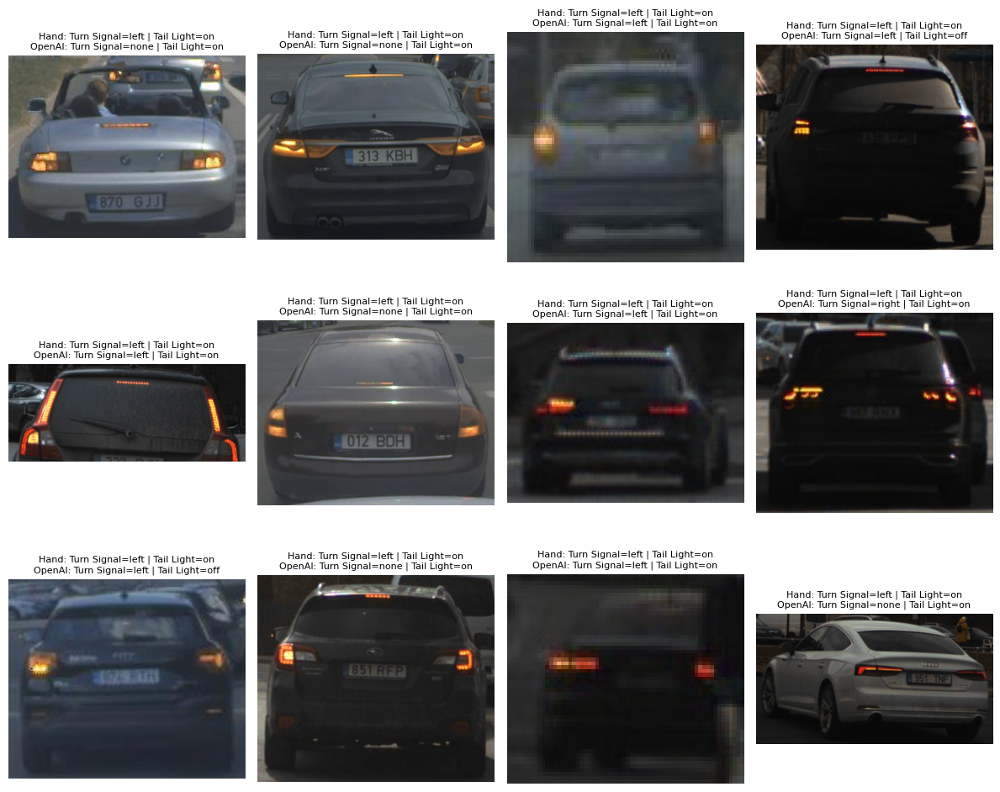

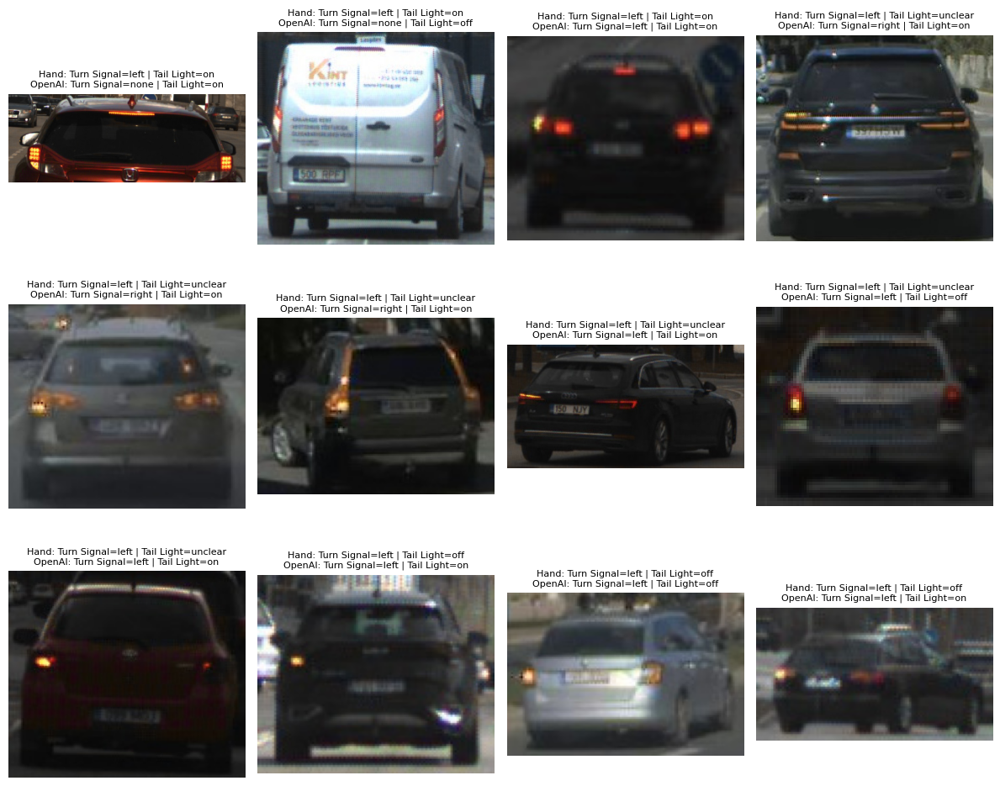

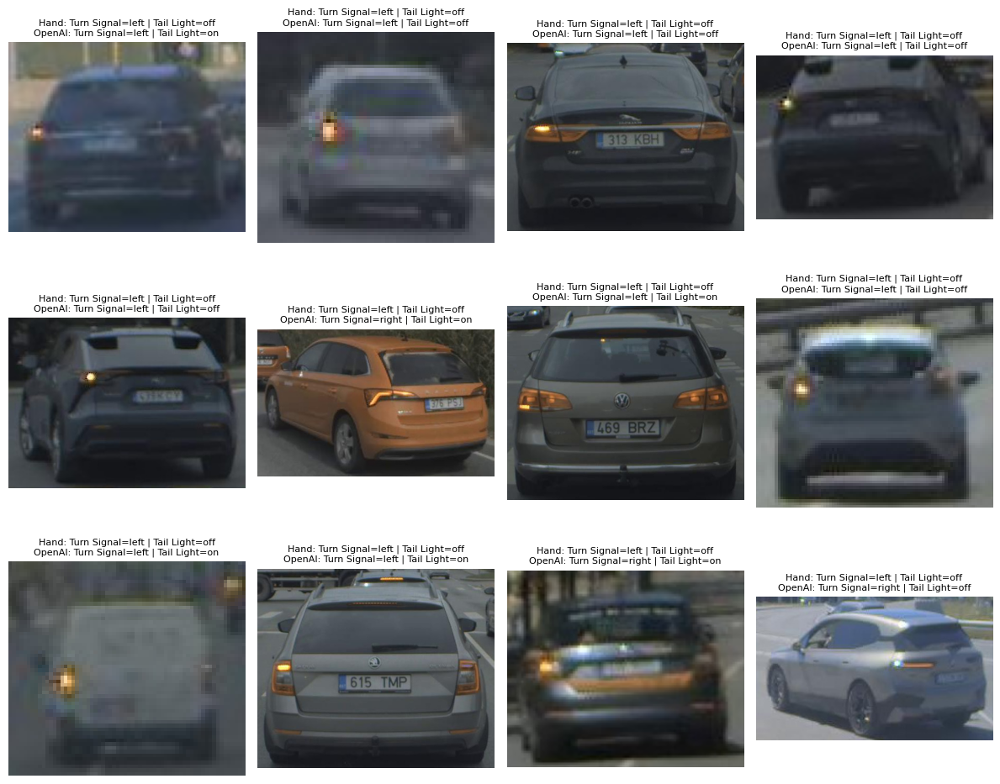

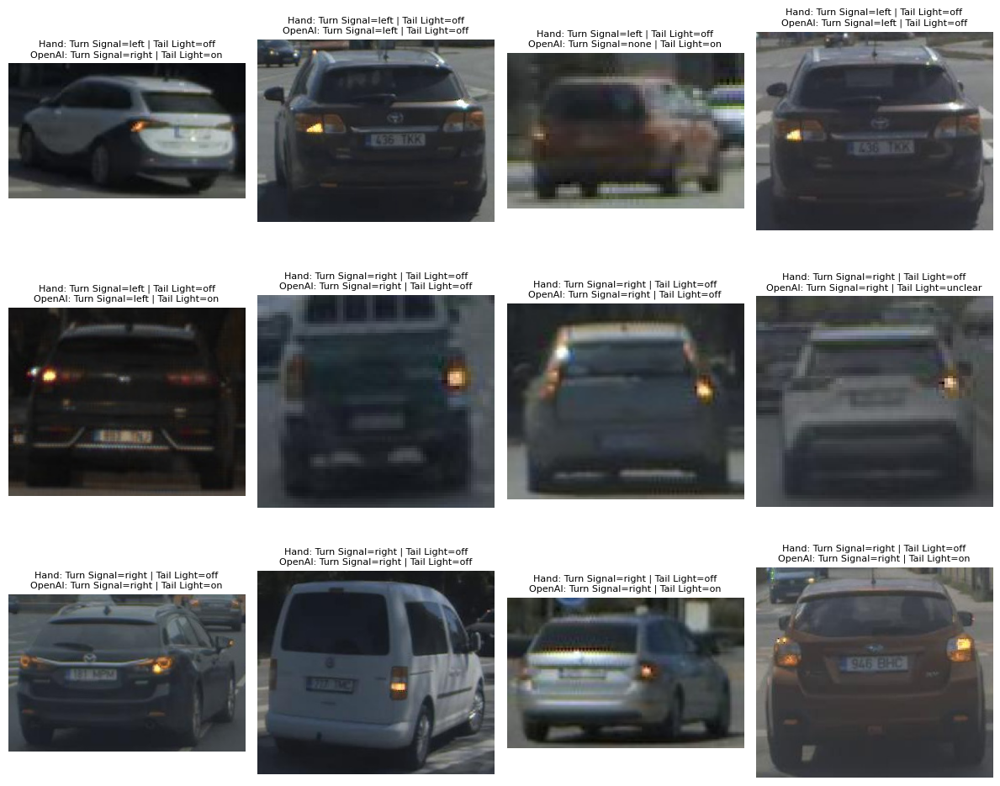

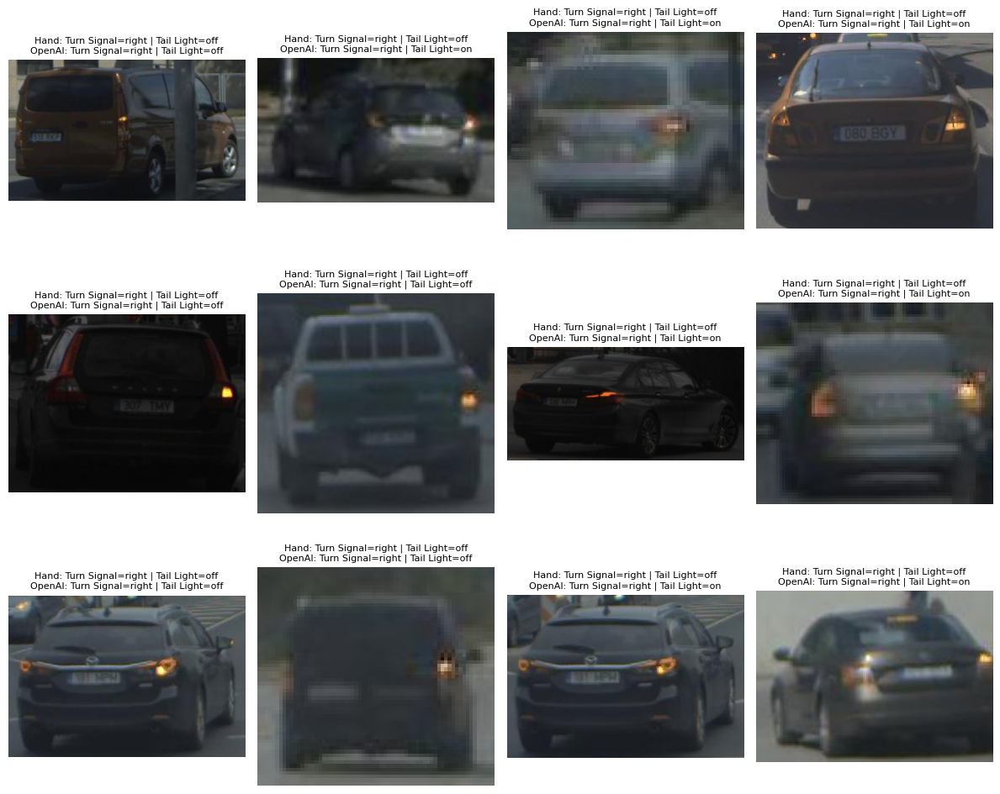

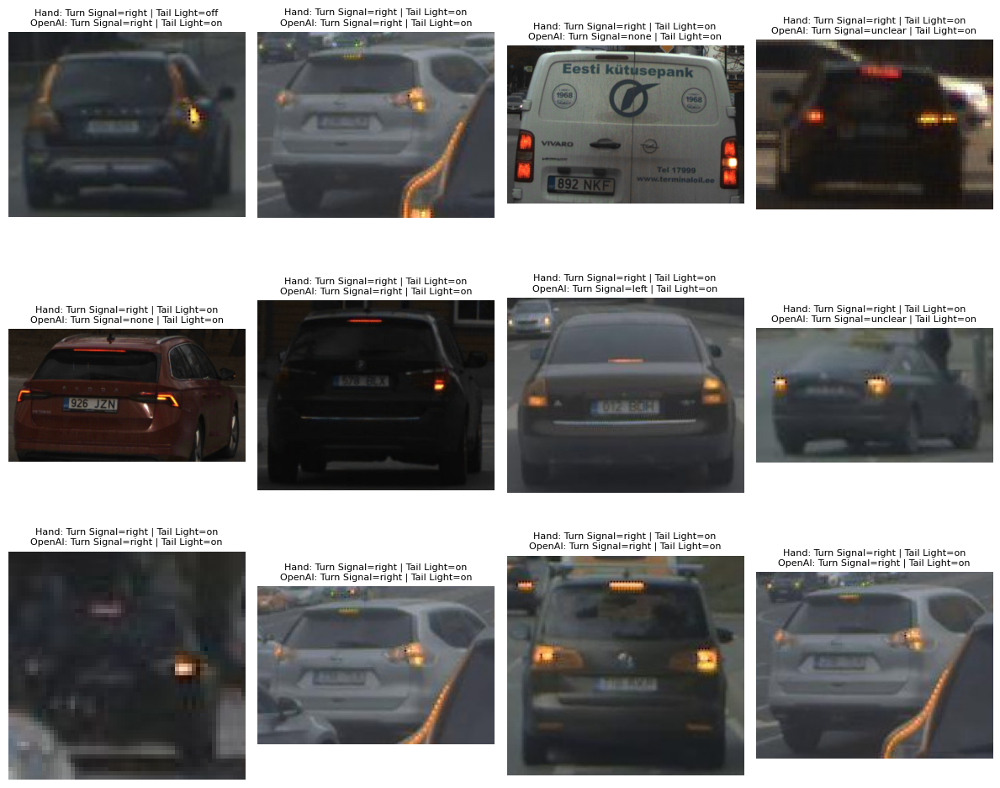

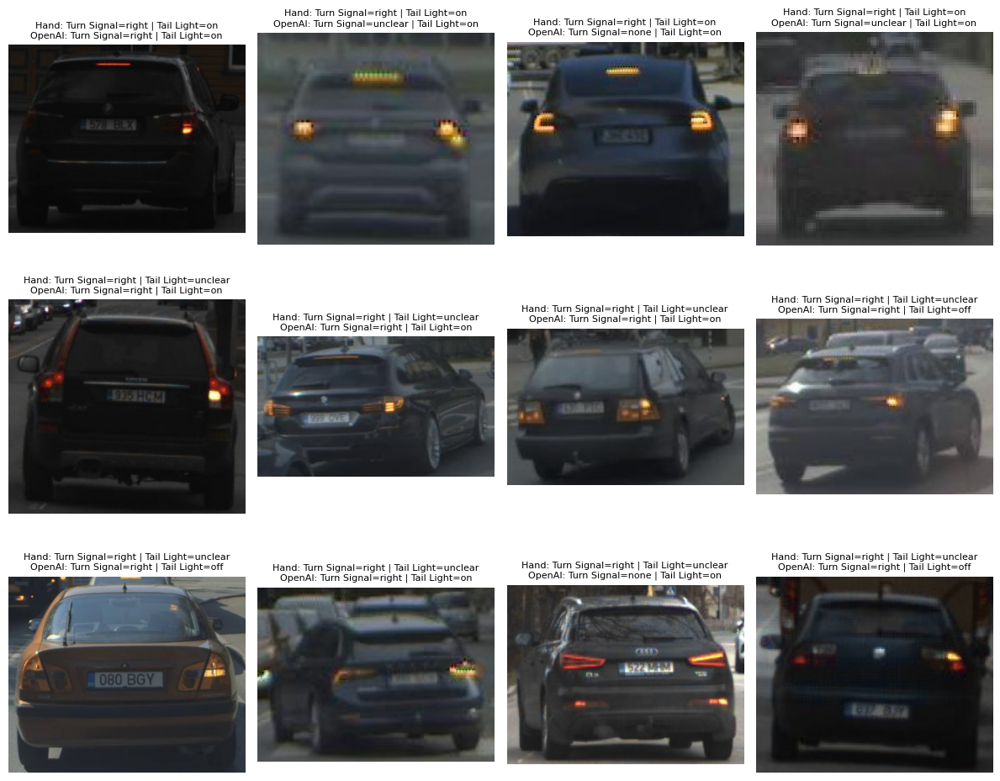

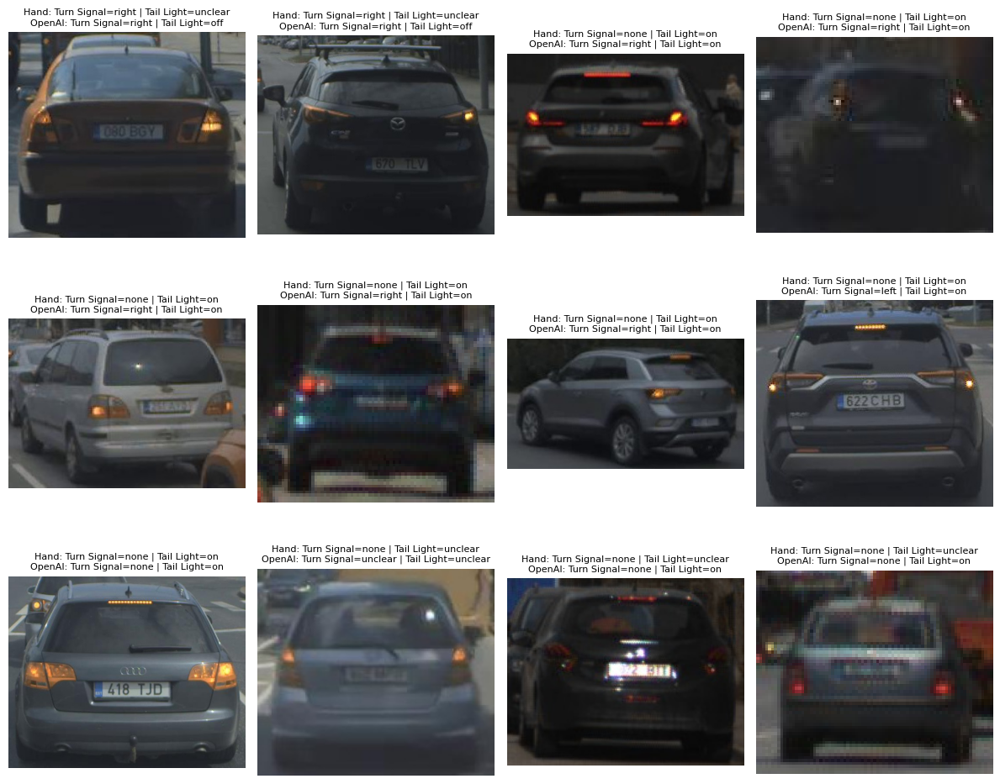

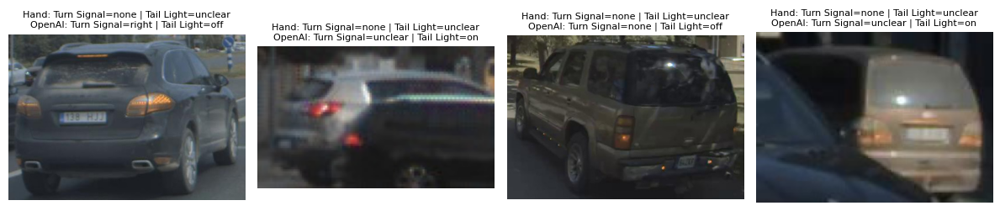

In [29]:
RESULTS_PATH = "../json_txt/gpt-4o_prompt2.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [30]:
with open("../json_txt/gpt-4o_prompt2.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 65.00%
Tail light accuracy: 52.00%


## gpt-4o-mini & prompt 3

Prompt 1:

```
"You are an advanced image analysis model. Look at the car image and determine:\n"
"1. turn_signal — one of: left, right, unclear, none \n"
"2. tail_light — one of: on, off, unclear \n\n"
"A turn signal should be lit up and indicating which direction the car is planning to turn \n"
"A tail light is on if lights other than the turn signal are on. \n"
"Return only valid JSON in this format:\n"
"{\n"
"  \"turn_signal\": \"left\",\n"
"  \"tail_light\": \"on\"\n"
"}"
```

Removing the none and both options, as perhaps this "confuses" the model.

Running at approx 8:03pm October 27, 2025

In [31]:
OUTPUT_FILE = "../json_txt/gpt-4o-mini_prompt3.json"

In [32]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none \n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "A turn signal should be lit up and indicating which direction the car is planning to turn \n"
                    "A tail light is on if lights other than the turn signal are on. \n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o-mini",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [33]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [34]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/100 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:   1%|▏                      | 1/100 [00:01<03:10,  1.93s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:   2%|▍                      | 2/100 [00:03<02:29,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0137653.jpg


Classifying images:   3%|▋                      | 3/100 [00:04<02:25,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-09-54_mapping_tartu_streets/camera_fl/predict/crops/car/012056.jpg


Classifying images:   4%|▉                      | 4/100 [00:06<02:24,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:   5%|█▏                     | 5/100 [00:07<02:07,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:   6%|█▍                     | 6/100 [00:08<02:11,  1.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-37-46_mapping_tartu_streets/camera_fl/predict/crops/car/0628284.jpg


Classifying images:   7%|█▌                     | 7/100 [00:10<02:08,  1.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:   8%|█▊                     | 8/100 [00:11<02:02,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:   9%|██                     | 9/100 [00:12<01:56,  1.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  10%|██▏                   | 10/100 [00:13<01:55,  1.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  11%|██▍                   | 11/100 [00:14<01:44,  1.17s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  12%|██▋                   | 12/100 [00:16<01:50,  1.25s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  13%|██▊                   | 13/100 [00:17<01:43,  1.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  14%|███                   | 14/100 [00:18<01:54,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  15%|███▎                  | 15/100 [00:19<01:44,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  16%|███▌                  | 16/100 [00:21<01:46,  1.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  17%|███▋                  | 17/100 [00:22<01:53,  1.36s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  18%|███▉                  | 18/100 [00:24<01:51,  1.36s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  19%|████▏                 | 19/100 [00:25<01:41,  1.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  20%|████▍                 | 20/100 [00:26<01:37,  1.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  21%|████▌                 | 21/100 [00:27<01:29,  1.13s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-35-00_mapping_tartu_streets/camera_fl/predict/crops/car/0381914.jpg


Classifying images:  22%|████▊                 | 22/100 [00:28<01:32,  1.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  23%|█████                 | 23/100 [00:29<01:31,  1.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  24%|█████▎                | 24/100 [00:31<01:40,  1.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0087872.jpg


Classifying images:  25%|█████▌                | 25/100 [00:32<01:43,  1.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  26%|█████▋                | 26/100 [00:34<01:48,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  27%|█████▉                | 27/100 [00:36<02:00,  1.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  28%|██████▏               | 28/100 [00:37<01:54,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_narrow_front/predict/crops/car/034470.jpg


Classifying images:  29%|██████▍               | 29/100 [00:39<01:42,  1.45s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  30%|██████▌               | 30/100 [00:40<01:45,  1.50s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0660002.jpg


Classifying images:  31%|██████▊               | 31/100 [00:42<01:49,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  32%|███████               | 32/100 [00:43<01:40,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  33%|███████▎              | 33/100 [00:44<01:32,  1.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0189483.jpg


Classifying images:  34%|███████▍              | 34/100 [00:46<01:27,  1.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0817932.jpg


Classifying images:  35%|███████▋              | 35/100 [00:46<01:17,  1.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  36%|███████▉              | 36/100 [00:48<01:14,  1.17s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  37%|████████▏             | 37/100 [00:49<01:14,  1.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  38%|████████▎             | 38/100 [00:50<01:17,  1.25s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  39%|████████▌             | 39/100 [00:52<01:21,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  40%|████████▊             | 40/100 [00:53<01:22,  1.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  41%|█████████             | 41/100 [00:54<01:14,  1.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_right/predict/crops/car/0587347.jpg


Classifying images:  42%|█████████▏            | 42/100 [00:55<01:12,  1.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  43%|█████████▍            | 43/100 [00:57<01:09,  1.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  44%|█████████▋            | 44/100 [00:58<01:08,  1.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  45%|█████████▉            | 45/100 [01:00<01:22,  1.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  46%|██████████            | 46/100 [01:02<01:32,  1.72s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  47%|██████████▎           | 47/100 [01:03<01:23,  1.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  48%|██████████▌           | 48/100 [01:05<01:14,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  49%|██████████▊           | 49/100 [01:06<01:12,  1.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/0168752.jpg


Classifying images:  50%|███████████           | 50/100 [01:07<01:08,  1.36s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  51%|███████████▏          | 51/100 [01:08<01:02,  1.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  52%|███████████▍          | 52/100 [01:09<00:57,  1.20s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  53%|███████████▋          | 53/100 [01:11<01:02,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  54%|███████████▉          | 54/100 [01:18<02:20,  3.05s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  55%|████████████          | 55/100 [01:19<01:56,  2.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0174873.jpg


Classifying images:  56%|████████████▎         | 56/100 [01:21<01:36,  2.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  57%|████████████▌         | 57/100 [01:22<01:19,  1.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▊         | 58/100 [01:23<01:07,  1.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  59%|████████████▉         | 59/100 [01:24<01:03,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  60%|█████████████▏        | 60/100 [01:26<01:02,  1.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  61%|█████████████▍        | 61/100 [01:27<00:55,  1.42s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  62%|█████████████▋        | 62/100 [01:28<00:54,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  63%|█████████████▊        | 63/100 [01:30<00:51,  1.39s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-03-44_mapping_tartu_streets/camera_fl/predict/crops/car/00640512.jpg


Classifying images:  64%|██████████████        | 64/100 [01:31<00:48,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  65%|██████████████▎       | 65/100 [01:33<00:59,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457733.jpg


Classifying images:  66%|██████████████▌       | 66/100 [01:35<00:52,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  67%|██████████████▋       | 67/100 [01:38<01:07,  2.03s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  68%|██████████████▉       | 68/100 [01:39<00:55,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  69%|███████████████▏      | 69/100 [01:40<00:47,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  70%|███████████████▍      | 70/100 [01:41<00:42,  1.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  71%|███████████████▌      | 71/100 [01:43<00:46,  1.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  72%|███████████████▊      | 72/100 [01:44<00:41,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  73%|████████████████      | 73/100 [01:46<00:41,  1.55s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0170983.jpg


Classifying images:  74%|████████████████▎     | 74/100 [01:47<00:39,  1.52s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  75%|████████████████▌     | 75/100 [01:49<00:36,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  76%|████████████████▋     | 76/100 [01:50<00:34,  1.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  77%|████████████████▉     | 77/100 [01:51<00:30,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  78%|█████████████████▏    | 78/100 [01:52<00:26,  1.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  79%|█████████████████▍    | 79/100 [01:54<00:28,  1.35s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  80%|█████████████████▌    | 80/100 [01:55<00:27,  1.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  81%|█████████████████▊    | 81/100 [01:57<00:26,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|██████████████████    | 82/100 [01:59<00:27,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  83%|██████████████████▎   | 83/100 [02:00<00:24,  1.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  84%|██████████████████▍   | 84/100 [02:01<00:23,  1.47s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  85%|██████████████████▋   | 85/100 [02:03<00:22,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████▉   | 86/100 [02:05<00:23,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-18-40_mapping_tartu_streets/camera_fl/predict/crops/car/0545602.jpg


Classifying images:  87%|███████████████████▏  | 87/100 [02:07<00:23,  1.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1186544.jpg


Classifying images:  88%|███████████████████▎  | 88/100 [02:08<00:18,  1.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0229413.jpg


Classifying images:  89%|███████████████████▌  | 89/100 [02:09<00:16,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-46-34_mapping_tartu_streets/camera_fl/predict/crops/car/0434254.jpg


Classifying images:  90%|███████████████████▊  | 90/100 [02:10<00:13,  1.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_left/predict/crops/car/068826.jpg


Classifying images:  91%|████████████████████  | 91/100 [02:12<00:11,  1.33s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-55-12_mapping_tartu_streets/camera_wide_front/predict/crops/car/038820.jpg


Classifying images:  92%|████████████████████▏ | 92/100 [02:13<00:09,  1.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0297162.jpg


Classifying images:  93%|████████████████████▍ | 93/100 [02:14<00:09,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-39-36_mapping_tartu_streets/camera_wide_front/predict/crops/car/027909.jpg


Classifying images:  94%|████████████████████▋ | 94/100 [02:16<00:08,  1.45s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-00-07_mapping_tartu_streets/camera_fl/predict/crops/car/015264.jpg


Classifying images:  95%|████████████████████▉ | 95/100 [02:17<00:06,  1.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/029027.jpg


Classifying images:  96%|█████████████████████ | 96/100 [02:18<00:05,  1.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0295092.jpg


Classifying images:  97%|█████████████████████▎| 97/100 [02:20<00:04,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0266875.jpg


Classifying images:  98%|█████████████████████▌| 98/100 [02:22<00:02,  1.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/034182.jpg


Classifying images:  99%|█████████████████████▊| 99/100 [02:23<00:01,  1.49s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_back/predict/crops/car/0045493.jpg


Classifying images: 100%|█████████████████████| 100/100 [02:25<00:00,  1.45s/it]


Done! Saved 100 results to ../json_txt/gpt-4o-mini_prompt3.json


### Display results side-by-side

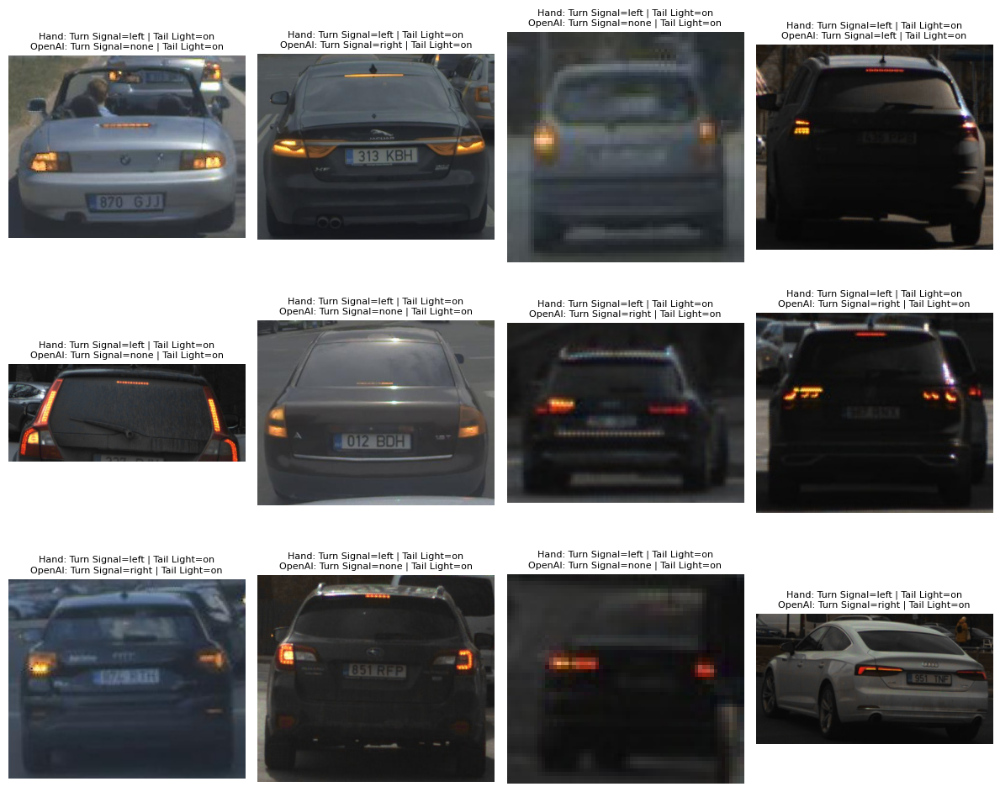

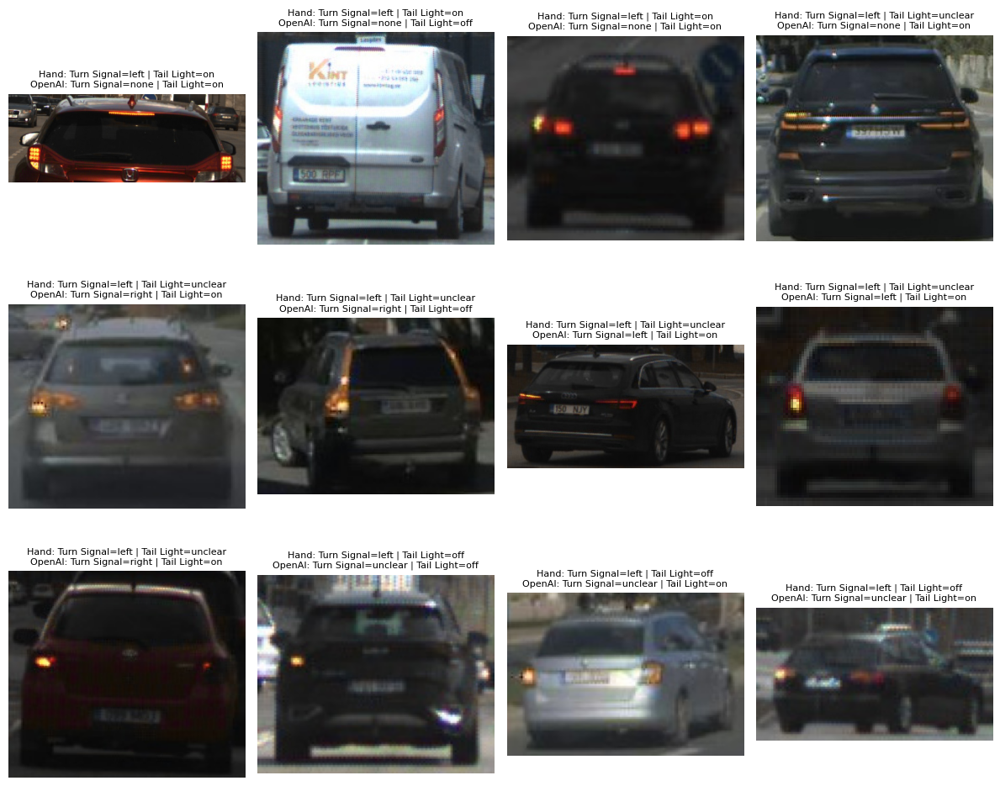

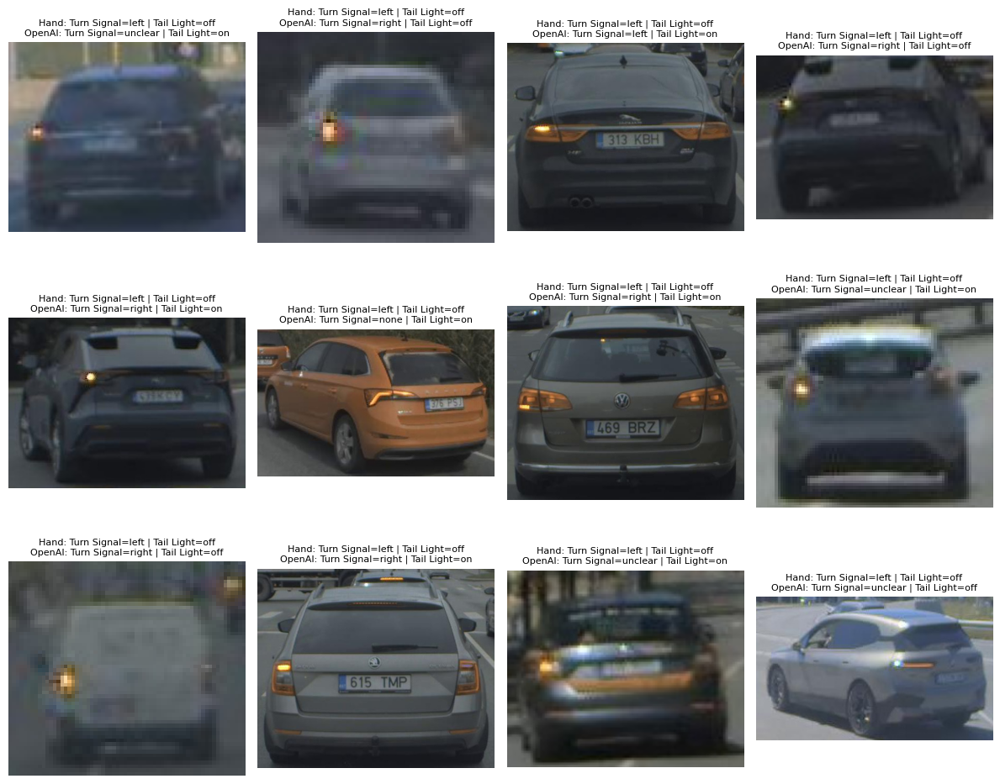

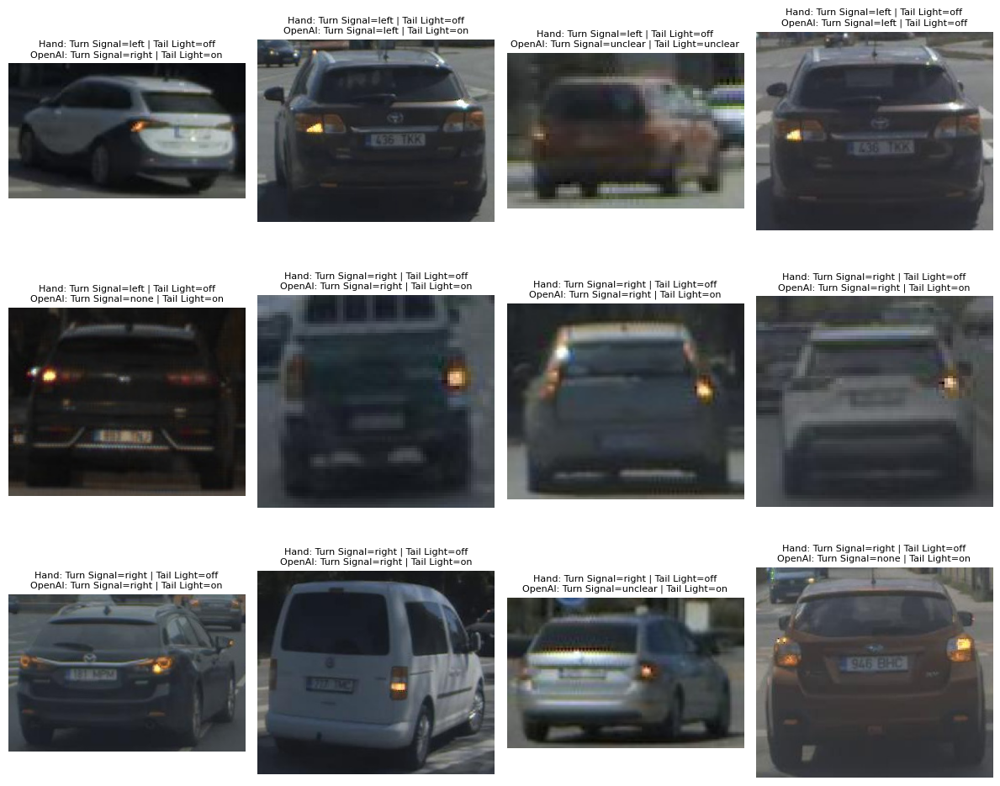

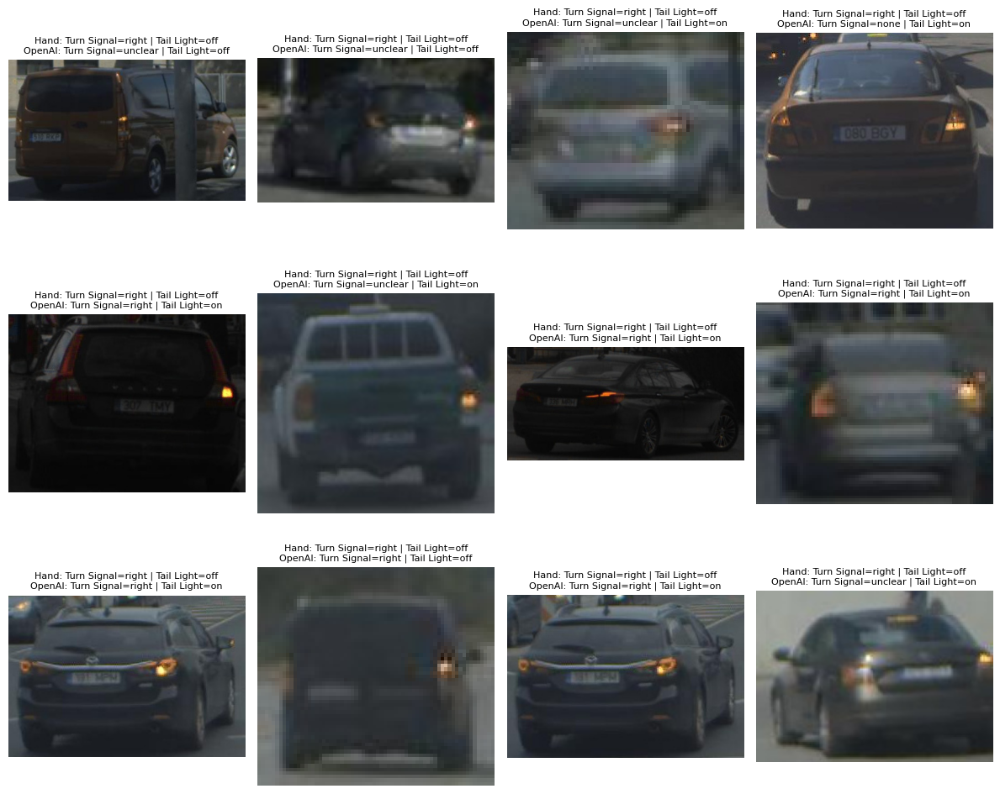

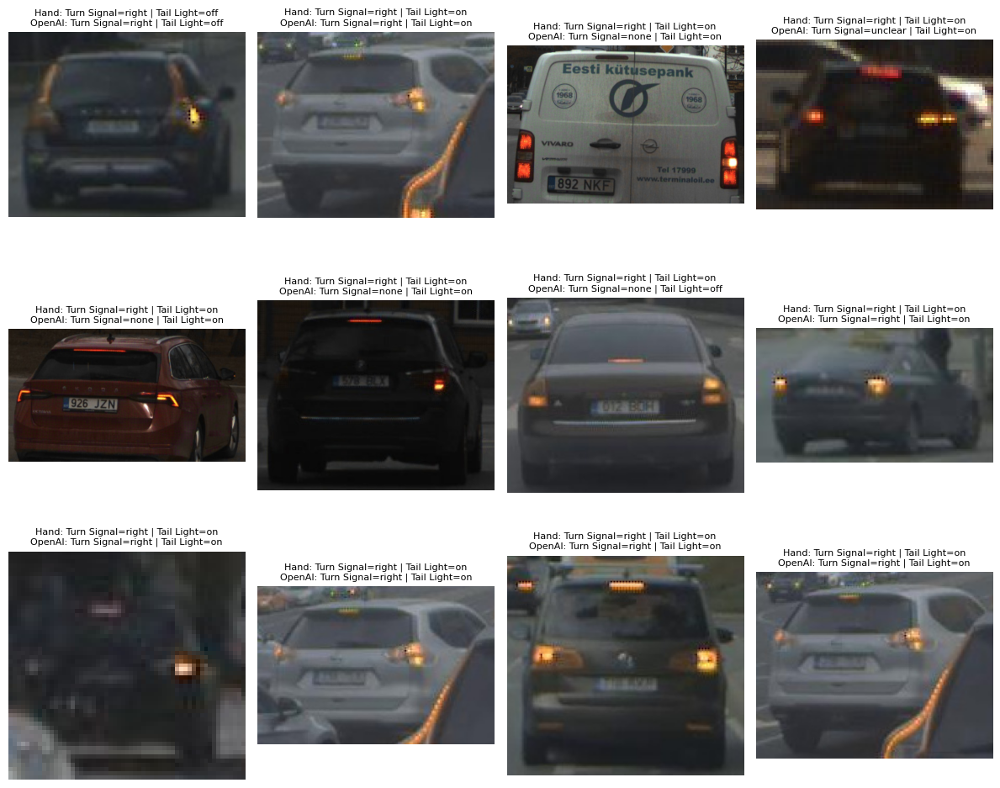

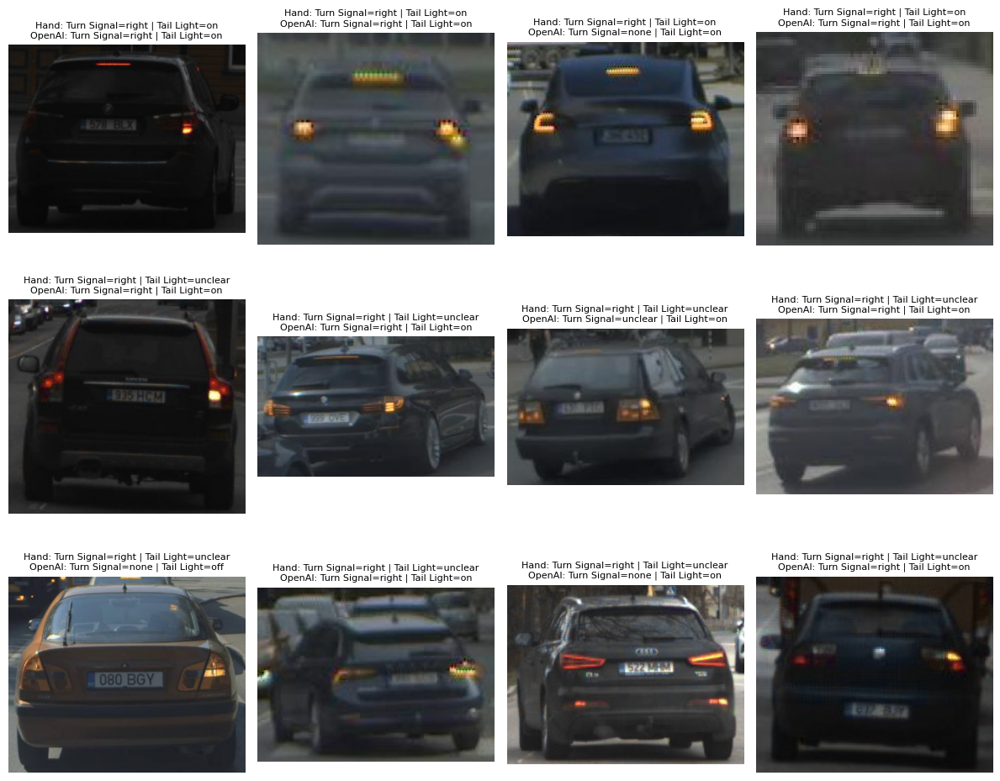

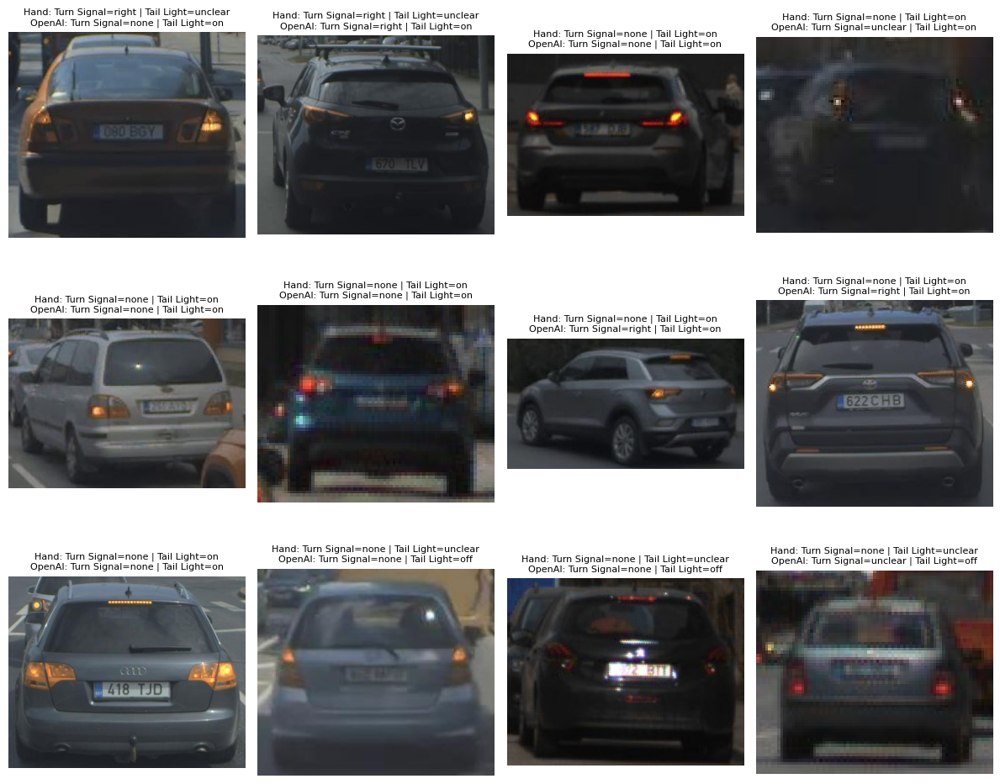

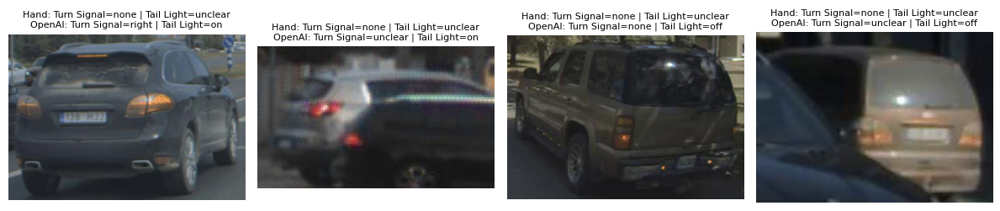

In [35]:
RESULTS_PATH = "../json_txt/gpt-4o-mini_prompt3.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [36]:
with open("../json_txt/gpt-4o-mini_prompt3.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 40.00%
Tail light accuracy: 45.00%


## gpt-4o & prompt 3

Removing the none and both options, as perhaps this "confuses" the model.

Running at approx 8:05, October 27, 2025

In [16]:
OUTPUT_FILE = "../json_txt/gpt-4o_prompt3_wednesday.json"

In [17]:
def classify_image(local_path):
    img_b64 = encode_image(local_path)
    prompt = {
        "role": "user",
        "content": [
            {
                "type": "text",
                "text": (
                    "You are an advanced image analysis model. Look at the car image and determine:\n"
                    "1. turn_signal — one of: left, right, unclear, none \n"
                    "2. tail_light — one of: on, off, unclear \n\n"
                    "Return only valid JSON in this format:\n"
                    "{\n"
                    "  \"turn_signal\": \"left\",\n"
                    "  \"tail_light\": \"on\"\n"
                    "}"
                ),
            },
            {"type": "image_url", "image_url": {"url": f"data:image/jpeg;base64,{img_b64}"}}
        ],
    }

    try:
        response = client.chat.completions.create(
            model="gpt-4o",
            messages=[prompt],
            temperature=0,
            response_format={"type": "json_object"}, 
        )
        return json.loads(response.choices[0].message.content)
    except Exception as e:
        print(f"Error processing {local_path}: {e}")
        return {"turn_signal": "none", "tail_light": "not_visible"}

In [18]:
with open(SAMPLED_PATH) as f:
    sampled = json.load(f)

In [19]:
results = []
for entry in tqdm(sampled, desc="Classifying images"): 
    local_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    print(local_path)
    result = classify_image(local_path)
    results.append({
        "image": entry["image"],
        "hand_label": {
            "turn_signal": entry["turn_signal"],
            "tail_light": entry["tail_light"]
        },
        "openai_label": result
    })

with open(OUTPUT_FILE, "w") as f:
    json.dump(results, f, indent=2)

print(f"\nDone! Saved {len(results)} results to {OUTPUT_FILE}")

Classifying images:   0%|                               | 0/130 [00:00<?, ?it/s]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-15-16-58_mapping_tartu_streets/camera_wide_back/predict/crops/car/1178962.jpg


Classifying images:   1%|▏                      | 1/130 [00:03<07:18,  3.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-16-49-42_mapping_tartu_streets/camera_wide_back/predict/crops/car/0664462.jpg


Classifying images:   2%|▎                      | 2/130 [00:06<06:17,  2.95s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0481604.jpg


Classifying images:   2%|▌                      | 3/130 [00:08<05:32,  2.62s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/042448.jpg


Classifying images:   3%|▋                      | 4/130 [00:11<05:44,  2.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_back/predict/crops/car/0767722.jpg


Classifying images:   4%|▉                      | 5/130 [00:13<05:01,  2.41s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/0524632.jpg


Classifying images:   5%|█                      | 6/130 [00:15<04:45,  2.30s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_back/predict/crops/car/044729.jpg


Classifying images:   5%|█▏                     | 7/130 [00:17<04:31,  2.21s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/017850.jpg


Classifying images:   6%|█▍                     | 8/130 [00:18<04:15,  2.09s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/099342.jpg


Classifying images:   7%|█▌                     | 9/130 [00:20<04:08,  2.06s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_back/predict/crops/car/04017214.jpg


Classifying images:   8%|█▋                    | 10/130 [00:22<03:46,  1.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-17-05-18_mapping_tartu_streets/camera_fl/predict/crops/car/007169.jpg


Classifying images:   8%|█▊                    | 11/130 [00:24<03:53,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-15-28_mapping_tartu_streets/camera_fl/predict/crops/car/0703634.jpg


Classifying images:   9%|██                    | 12/130 [00:26<03:54,  1.99s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/082365.jpg


Classifying images:  10%|██▏                   | 13/130 [00:28<03:37,  1.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-10-46_mapping_tartu/camera_fl/predict/crops/car/014402.jpg


Classifying images:  11%|██▎                   | 14/130 [00:29<03:17,  1.70s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0480492.jpg


Classifying images:  12%|██▌                   | 15/130 [00:32<03:54,  2.04s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-27-13-13-06_mapping_tartu_streets/camera_fl/predict/crops/car/0209445.jpg


Classifying images:  12%|██▋                   | 16/130 [00:34<03:39,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/0035026.jpg


Classifying images:  13%|██▉                   | 17/130 [00:35<03:25,  1.82s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_right/predict/crops/car/016063.jpg


Classifying images:  14%|███                   | 18/130 [00:36<03:09,  1.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/068034.jpg


Classifying images:  15%|███▏                  | 19/130 [00:39<03:36,  1.95s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/031208.jpg


Classifying images:  15%|███▍                  | 20/130 [00:46<06:33,  3.58s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-24-06_mapping_tartu_streets/camera_fl/predict/crops/car/010273.jpg


Classifying images:  16%|███▌                  | 21/130 [00:48<05:33,  3.06s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_wide_front/predict/crops/car/0534753.jpg


Classifying images:  17%|███▋                  | 22/130 [00:50<04:37,  2.57s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-13-07-29_mapping_tartu_streets/camera_fl/predict/crops/car/020521.jpg


Classifying images:  18%|███▉                  | 23/130 [00:51<04:05,  2.29s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-17-08-54_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0777026.jpg


Classifying images:  18%|████                  | 24/130 [00:53<03:35,  2.03s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-13-59-30_mapping_tartu_streets/camera_fl/predict/crops/car/003536.jpg


Classifying images:  19%|████▏                 | 25/130 [00:54<03:16,  1.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-10-15-36-40_mapping_tartu_streets/camera_fl/predict/crops/car/033390.jpg


Classifying images:  20%|████▍                 | 26/130 [00:56<03:03,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-13-05-46_mapping_tartu_streets/camera_narrow_front/predict/crops/car/006669.jpg


Classifying images:  21%|████▌                 | 27/130 [01:12<10:16,  5.98s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/052940.jpg


Classifying images:  22%|████▋                 | 28/130 [01:13<07:48,  4.59s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/0054485.jpg


Classifying images:  22%|████▉                 | 29/130 [01:15<06:23,  3.80s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0243382.jpg


Classifying images:  23%|█████                 | 30/130 [01:16<05:11,  3.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0512153.jpg


Classifying images:  24%|█████▏                | 31/130 [01:18<04:25,  2.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/065766.jpg


Classifying images:  25%|█████▍                | 32/130 [01:21<04:21,  2.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-48-25_mapping_tartu_streets/camera_fl/predict/crops/car/030300.jpg


Classifying images:  25%|█████▌                | 33/130 [01:23<04:03,  2.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/087911.jpg


Classifying images:  26%|█████▊                | 34/130 [01:25<03:48,  2.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-08-15-04-47_mapping_tartu_streets/camera_fl/predict/crops/car/0041512.jpg


Classifying images:  27%|█████▉                | 35/130 [01:27<03:36,  2.28s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-41-43_mapping_tartu_streets/camera_fl/predict/crops/car/0079844.jpg


Classifying images:  28%|██████                | 36/130 [01:29<03:21,  2.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-11-35_mapping_tartu_streets/camera_wide_front/predict/crops/car/0510612.jpg


Classifying images:  28%|██████▎               | 37/130 [01:31<03:21,  2.16s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/016373.jpg


Classifying images:  29%|██████▍               | 38/130 [01:34<03:28,  2.27s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0136032.jpg


Classifying images:  30%|██████▌               | 39/130 [01:36<03:31,  2.32s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-25-15_mapping_tartu_streets/camera_fl/predict/crops/car/002407.jpg


Classifying images:  31%|██████▊               | 40/130 [01:39<03:35,  2.40s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-21-41_mapping_tartu_streets/camera_wide_front/predict/crops/car/055117.jpg


Classifying images:  32%|██████▉               | 41/130 [01:41<03:31,  2.37s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/0163663.jpg


Classifying images:  32%|███████               | 42/130 [01:43<03:29,  2.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142863.jpg


Classifying images:  33%|███████▎              | 43/130 [01:46<03:32,  2.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/051625.jpg


Classifying images:  34%|███████▍              | 44/130 [01:49<03:39,  2.56s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-14-23-04_mapping_tartu_streets/camera_fl/predict/crops/car/016336.jpg


Classifying images:  35%|███████▌              | 45/130 [01:51<03:35,  2.54s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_back/predict/crops/car/009482.jpg


Classifying images:  35%|███████▊              | 46/130 [01:54<03:30,  2.51s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/000357.jpg


Classifying images:  36%|███████▉              | 47/130 [01:56<03:24,  2.46s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-56-40_mapping_tartu_streets/camera_wide_front/predict/crops/car/065790.jpg


Classifying images:  37%|████████              | 48/130 [01:59<03:31,  2.58s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-37-25_mapping_tartu_streets/camera_fl/predict/crops/car/005967.jpg


Classifying images:  38%|████████▎             | 49/130 [02:01<03:30,  2.60s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-02-50_mapping_tartu_streets/camera_narrow_front/predict/crops/car/036552.jpg


Classifying images:  38%|████████▍             | 50/130 [02:04<03:15,  2.44s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-06-03_mapping_tartu_streets/camera_fl/predict/crops/car/0497392.jpg


Classifying images:  39%|████████▋             | 51/130 [02:05<02:51,  2.18s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_wide_front/predict/crops/car/0882582.jpg


Classifying images:  40%|████████▊             | 52/130 [02:07<02:51,  2.19s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-19-07_mapping_tartu_streets/camera_wide_front/predict/crops/car/0910772.jpg


Classifying images:  41%|████████▉             | 53/130 [02:09<02:35,  2.02s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088084.jpg


Classifying images:  42%|█████████▏            | 54/130 [02:11<02:28,  1.95s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_left/predict/crops/car/018209.jpg


Classifying images:  42%|█████████▎            | 55/130 [02:13<02:23,  1.91s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/011235.jpg


Classifying images:  43%|█████████▍            | 56/130 [02:14<02:15,  1.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/021477.jpg


Classifying images:  44%|█████████▋            | 57/130 [02:16<02:16,  1.87s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_back/predict/crops/car/015223.jpg


Classifying images:  45%|█████████▊            | 58/130 [02:19<02:40,  2.22s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-16-27-09_mapping_tartu_streets/camera_fl/predict/crops/car/0011474.jpg


Classifying images:  45%|█████████▉            | 59/130 [02:21<02:27,  2.08s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-53-54_mapping_tartu_streets/camera_fl/predict/crops/car/017392.jpg


Classifying images:  46%|██████████▏           | 60/130 [02:22<02:09,  1.85s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-34-13_mapping_tartu_streets/camera_wide_front/predict/crops/car/021443.jpg


Classifying images:  47%|██████████▎           | 61/130 [02:24<02:16,  1.97s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0272457.jpg


Classifying images:  48%|██████████▍           | 62/130 [02:26<02:09,  1.90s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-14-33-25_mapping_tartu_streets/camera_narrow_front/predict/crops/car/088076.jpg


Classifying images:  48%|██████████▋           | 63/130 [02:28<02:08,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-13-00-58_mapping_tartu_streets/camera_wide_front/predict/crops/car/033456.jpg


Classifying images:  49%|██████████▊           | 64/130 [02:30<02:02,  1.86s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-48-44_mapping_tartu_streets/camera_wide_front/predict/crops/car/0344402.jpg


Classifying images:  50%|███████████           | 65/130 [02:32<01:59,  1.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0548522.jpg


Classifying images:  51%|███████████▏          | 66/130 [02:33<01:55,  1.80s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/093787.jpg


Classifying images:  52%|███████████▎          | 67/130 [02:35<01:52,  1.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_left/predict/crops/car/076217.jpg


Classifying images:  52%|███████████▌          | 68/130 [02:37<01:57,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-14-24-35_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0920042.jpg


Classifying images:  53%|███████████▋          | 69/130 [02:39<01:55,  1.89s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_narrow_front/predict/crops/car/001653.jpg


Classifying images:  54%|███████████▊          | 70/130 [02:41<01:49,  1.82s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/042128.jpg


Classifying images:  55%|████████████          | 71/130 [02:43<01:48,  1.83s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074515.jpg


Classifying images:  55%|████████████▏         | 72/130 [02:44<01:42,  1.76s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-17-40_mapping_tartu_streets/camera_fl/predict/crops/car/002217.jpg


Classifying images:  56%|████████████▎         | 73/130 [02:46<01:37,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0586547.jpg


Classifying images:  57%|████████████▌         | 74/130 [02:47<01:33,  1.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0360963.jpg


Classifying images:  58%|████████████▋         | 75/130 [02:49<01:24,  1.53s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171452.jpg


Classifying images:  58%|████████████▊         | 76/130 [02:51<01:36,  1.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_front/predict/crops/car/037819.jpg


Classifying images:  59%|█████████████         | 77/130 [02:53<01:33,  1.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-13-58-31_mapping_tartu_streets/camera_narrow_front/predict/crops/car/084773.jpg


Classifying images:  60%|█████████████▏        | 78/130 [02:54<01:29,  1.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-17-08_mapping_tartu_streets/camera_wide_right/predict/crops/car/018806.jpg


Classifying images:  61%|█████████████▎        | 79/130 [02:56<01:29,  1.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-14-36-59_mapping_tartu_streets/camera_narrow_front/predict/crops/car/099235.jpg


Classifying images:  62%|█████████████▌        | 80/130 [02:58<01:22,  1.66s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-02-12-24-48_mapping_tartu_streets_pacmod_sys_fault_in_the_end/camera_fl/predict/crops/car/006690.jpg


Classifying images:  62%|█████████████▋        | 81/130 [03:00<01:25,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-04-45_mapping_tartu_streets/camera_wide_back/predict/crops/car/0398112.jpg


Classifying images:  63%|█████████████▉        | 82/130 [03:01<01:23,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-09-15-57-33_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0369393.jpg


Classifying images:  64%|██████████████        | 83/130 [03:03<01:21,  1.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171472.jpg


Classifying images:  65%|██████████████▏       | 84/130 [03:04<01:13,  1.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0171712.jpg


Classifying images:  65%|██████████████▍       | 85/130 [03:06<01:17,  1.72s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0245093.jpg


Classifying images:  66%|██████████████▌       | 86/130 [03:08<01:14,  1.70s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-16-06-06_mapping_tartu_streets/camera_fl/predict/crops/car/0061072.jpg


Classifying images:  67%|██████████████▋       | 87/130 [03:10<01:13,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-31-21_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/028862.jpg


Classifying images:  68%|██████████████▉       | 88/130 [03:11<01:08,  1.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0182613.jpg


Classifying images:  68%|███████████████       | 89/130 [03:15<01:27,  2.14s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-43-08_mapping_tartu_streets/camera_narrow_front/predict/crops/car/024736.jpg


Classifying images:  69%|███████████████▏      | 90/130 [03:17<01:23,  2.09s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_wide_front/predict/crops/car/0162332.jpg


Classifying images:  70%|███████████████▍      | 91/130 [03:19<01:26,  2.23s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-03-25-16-23-55_mapping_tartu/camera_fl/predict/crops/car/0244693.jpg


Classifying images:  71%|███████████████▌      | 92/130 [03:21<01:18,  2.07s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074169.jpg


Classifying images:  72%|███████████████▋      | 93/130 [03:22<01:12,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142052.jpg


Classifying images:  72%|███████████████▉      | 94/130 [03:24<01:09,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-54-22_mapping_tartu_streets/camera_fl/predict/crops/car/002694.jpg


Classifying images:  73%|████████████████      | 95/130 [03:27<01:14,  2.12s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/045786.jpg


Classifying images:  74%|████████████████▏     | 96/130 [03:29<01:08,  2.00s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/0087493.jpg


Classifying images:  75%|████████████████▍     | 97/130 [03:30<01:03,  1.92s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_front/predict/crops/car/074134.jpg


Classifying images:  75%|████████████████▌     | 98/130 [03:32<00:55,  1.74s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-16-14-47-30_mapping_tartu_streets/camera_wide_right/predict/crops/car/0716804.jpg


Classifying images:  76%|████████████████▊     | 99/130 [03:33<00:53,  1.73s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0316302.jpg


Classifying images:  77%|████████████████▏    | 100/130 [03:35<00:50,  1.69s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-14-56-18_mapping_tartu_streets/camera_fl/predict/crops/car/0457723.jpg


Classifying images:  78%|████████████████▎    | 101/130 [03:37<00:51,  1.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-16-03-30_mapping_tartu_streets/camera_wide_front/predict/crops/car/142241.jpg


Classifying images:  78%|████████████████▍    | 102/130 [03:39<00:50,  1.79s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0315954.jpg


Classifying images:  79%|████████████████▋    | 103/130 [03:41<00:48,  1.80s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0318053.jpg


Classifying images:  80%|████████████████▊    | 104/130 [03:42<00:43,  1.68s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-09-53-47_mapping_tartu_streets_bus_stops/camera_narrow_front/predict/crops/car/023354.jpg


Classifying images:  81%|████████████████▉    | 105/130 [03:44<00:41,  1.67s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-13-29-02_mapping_tartu_streets/camera_narrow_front/predict/crops/car/055477.jpg


Classifying images:  82%|█████████████████    | 106/130 [03:46<00:45,  1.88s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-16-15-44-10_mapping_tartu_streets/camera_narrow_front/predict/crops/car/1305232.jpg


Classifying images:  82%|█████████████████▎   | 107/130 [03:47<00:40,  1.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016402.jpg


Classifying images:  83%|█████████████████▍   | 108/130 [03:49<00:39,  1.78s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/016196.jpg


Classifying images:  84%|█████████████████▌   | 109/130 [03:52<00:40,  1.95s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-08-22-10-38-05_mapping_tartu_streets_bus_stops/camera_wide_front/predict/crops/car/0352562.jpg


Classifying images:  85%|█████████████████▊   | 110/130 [03:53<00:36,  1.84s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-13-49-30_mapping_tartu_streets/camera_fl/predict/crops/car/032165.jpg


Classifying images:  85%|█████████████████▉   | 111/130 [03:55<00:32,  1.70s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-55-13_mapping_tartu_streets/camera_narrow_front/predict/crops/car/042662.jpg


Classifying images:  86%|██████████████████   | 112/130 [03:56<00:29,  1.65s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_narrow_front/predict/crops/car/0555872.jpg


Classifying images:  87%|██████████████████▎  | 113/130 [03:58<00:27,  1.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_right/predict/crops/car/005829.jpg


Classifying images:  88%|██████████████████▍  | 114/130 [04:00<00:29,  1.82s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013955.jpg


Classifying images:  88%|██████████████████▌  | 115/130 [04:02<00:26,  1.75s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-15-09-27_mapping_tartu_streets/camera_fl/predict/crops/car/0233342.jpg


Classifying images:  89%|██████████████████▋  | 116/130 [04:04<00:27,  1.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-24-15-17-40_mapping_tartu_streets/camera_fl/predict/crops/car/002046.jpg


Classifying images:  90%|██████████████████▉  | 117/130 [04:05<00:23,  1.80s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-18-14-49-13_mapping_tartu_streets/camera_fl/predict/crops/car/013683.jpg


Classifying images:  91%|███████████████████  | 118/130 [04:07<00:20,  1.71s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-12-16-02-09_mapping_tartu_streets/camera_fl/predict/crops/car/06954010.jpg


Classifying images:  92%|███████████████████▏ | 119/130 [04:08<00:18,  1.64s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-16-15-11-29_mapping_tartu_streets/camera_fl/predict/crops/car/0502439.jpg


Classifying images:  92%|███████████████████▍ | 120/130 [04:10<00:16,  1.61s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-15-50_mapping_tartu_streets/camera_wide_front/predict/crops/car/0189655.jpg


Classifying images:  93%|███████████████████▌ | 121/130 [04:27<00:57,  6.34s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-10-12-53-29_mapping_tartu_streets/camera_wide_back/predict/crops/car/0352103.jpg


Classifying images:  94%|███████████████████▋ | 122/130 [04:29<00:39,  4.94s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_narrow_front/predict/crops/car/0108993.jpg


Classifying images:  95%|███████████████████▊ | 123/130 [04:31<00:27,  3.94s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-13-41-48_mapping_tartu_streets_traffic_lights_ouster_lidar/camera_narrow_front/predict/crops/car/0223205.jpg


Classifying images:  95%|████████████████████ | 124/130 [04:32<00:19,  3.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-04-09-16-43-04_mapping_tartu_streets/camera_fl/predict/crops/car/029322.jpg


Classifying images:  96%|████████████████████▏| 125/130 [04:34<00:13,  2.77s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-08-12-01-14_mapping_tartu_streets/camera_wide_front/predict/crops/car/0092332.jpg


Classifying images:  97%|████████████████████▎| 126/130 [04:36<00:09,  2.43s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-09-05-14-18-54_mapping_tartu_streets_traffic_lights_ouster_lidar_2/camera_wide_front/predict/crops/car/0106795.jpg


Classifying images:  98%|████████████████████▌| 127/130 [04:37<00:06,  2.26s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-14-32-54_mapping_tartu_streets/camera_wide_front/predict/crops/car/015929.jpg


Classifying images:  98%|████████████████████▋| 128/130 [04:43<00:06,  3.38s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-39-14_mapping_tartu_streets/camera_wide_left/predict/crops/car/053001.jpg


Classifying images:  99%|████████████████████▊| 129/130 [04:45<00:02,  2.96s/it]

../sampled_images/gpfs/space/projects/ml2024/2024-07-11-15-51-59_mapping_tartu_streets/camera_wide_back/predict/crops/car/067677.jpg


Classifying images: 100%|█████████████████████| 130/130 [04:47<00:00,  2.21s/it]


Done! Saved 130 results to ../json_txt/gpt-4o_prompt3_wednesday.json


### Display results side-by-side

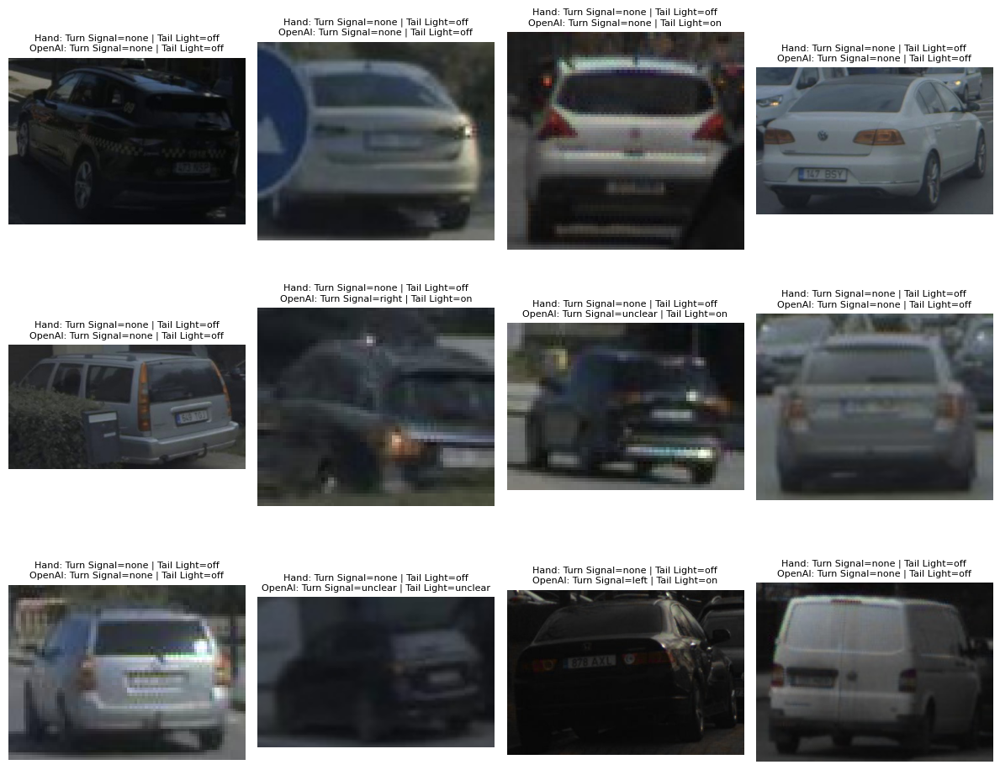

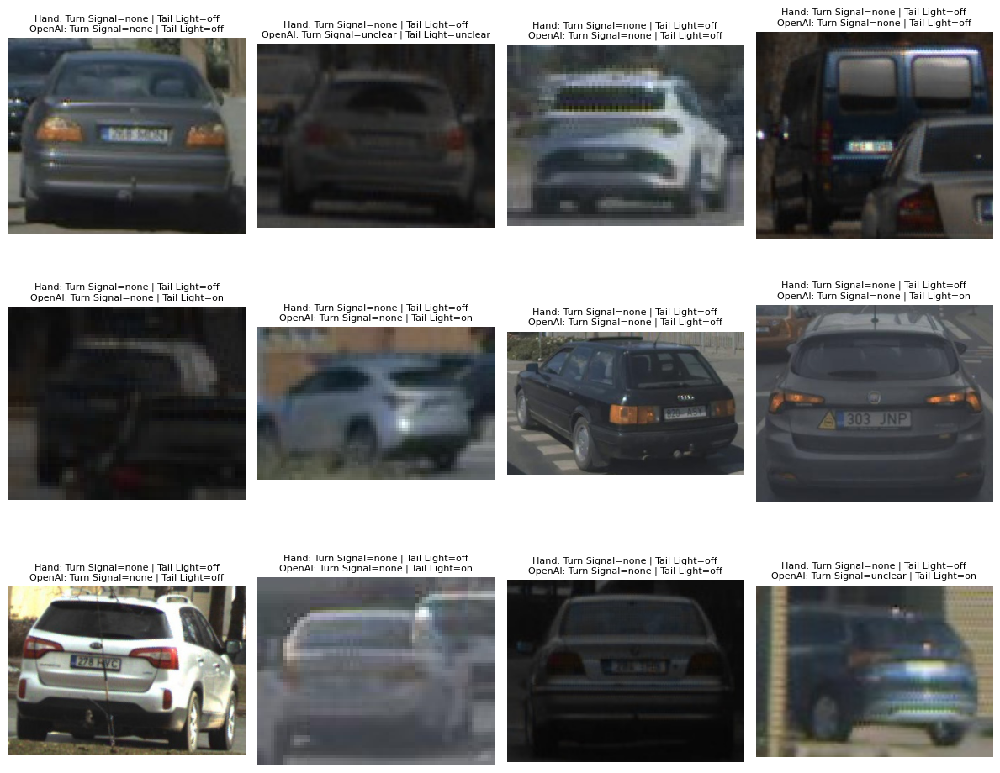

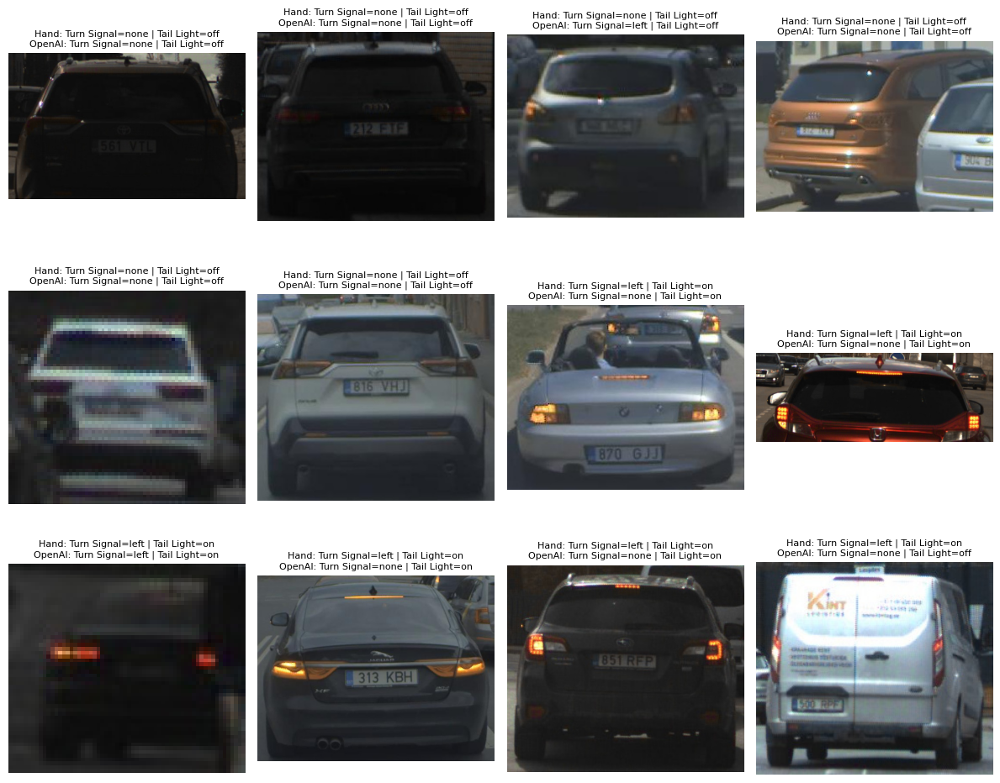

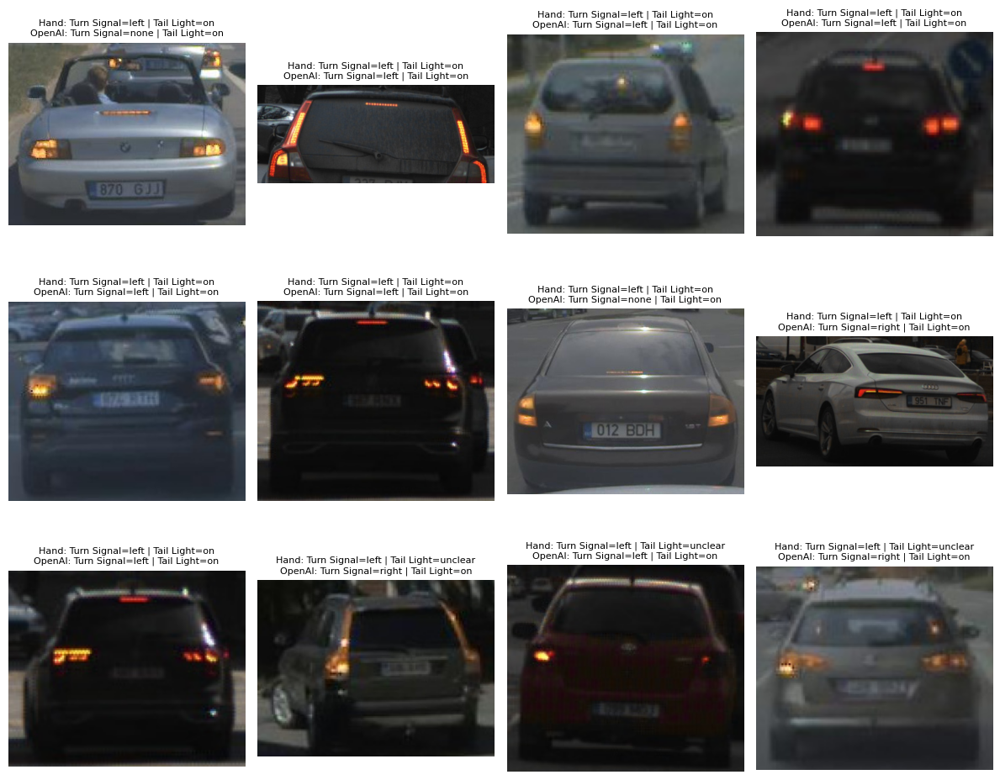

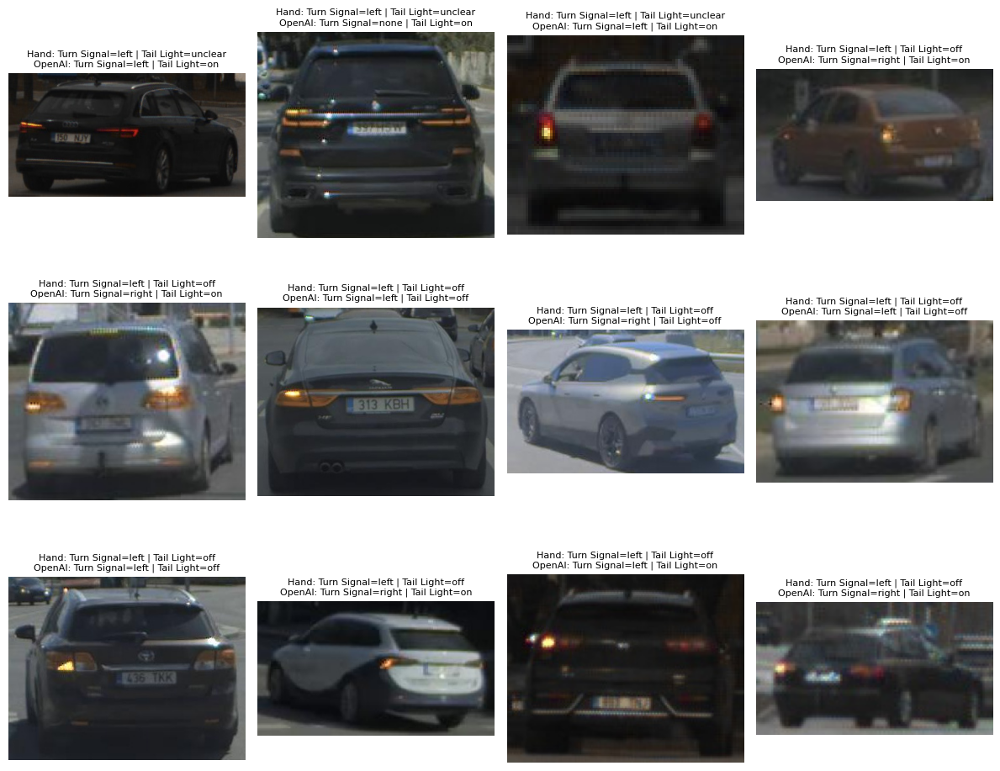

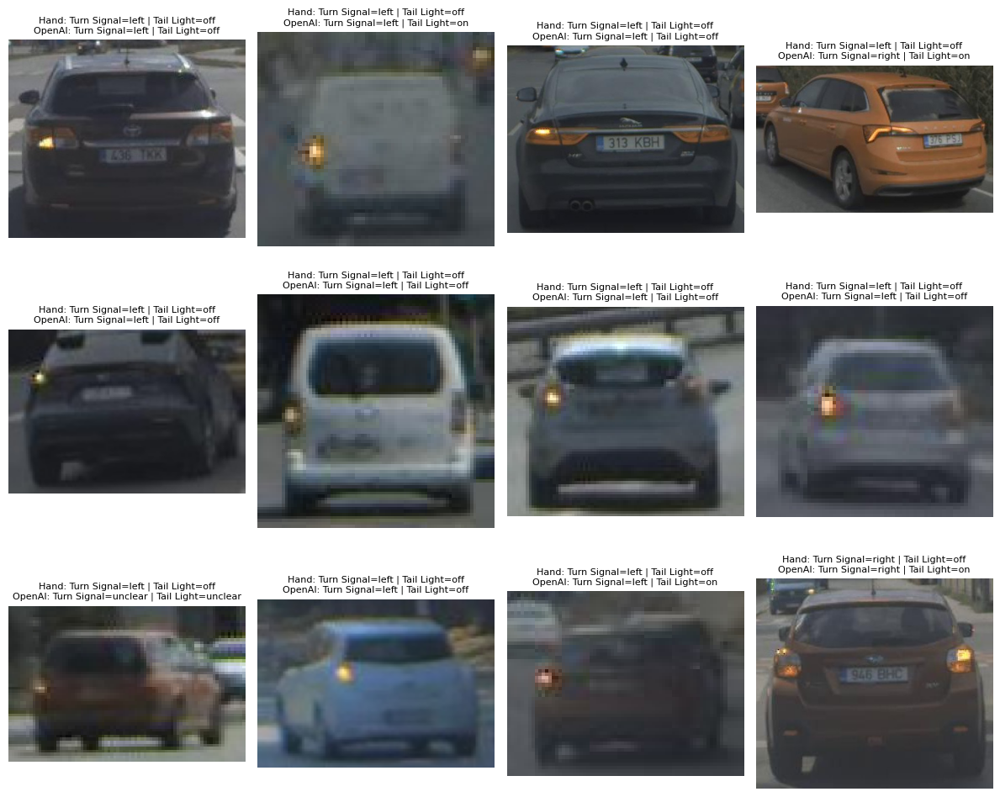

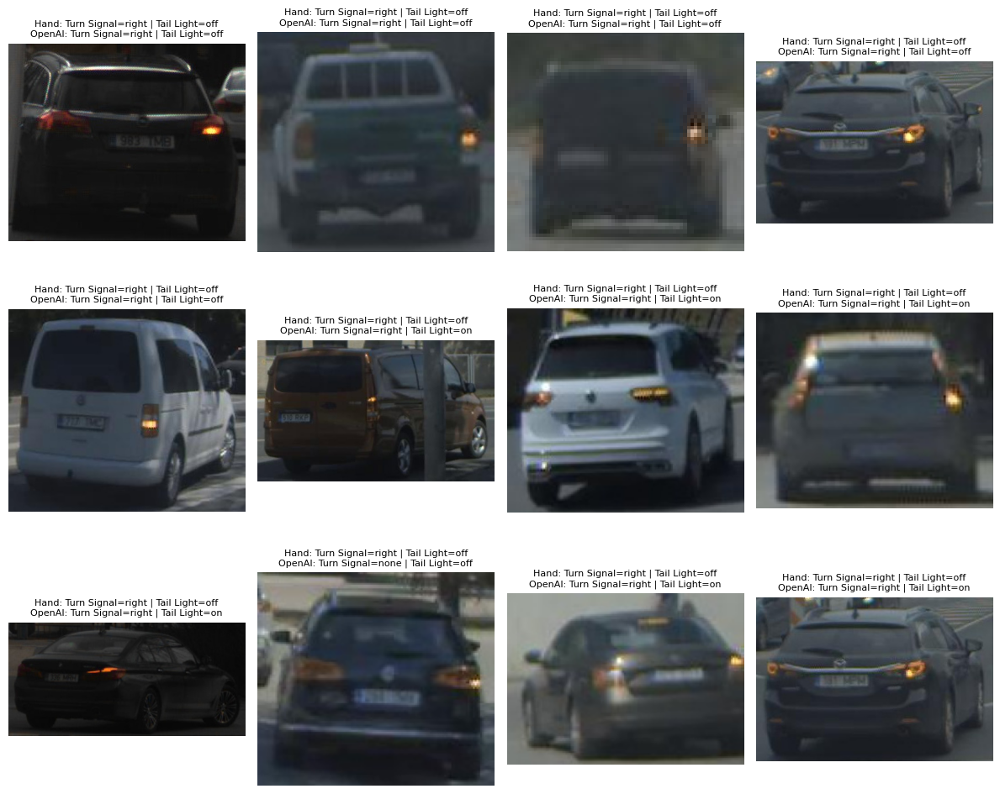

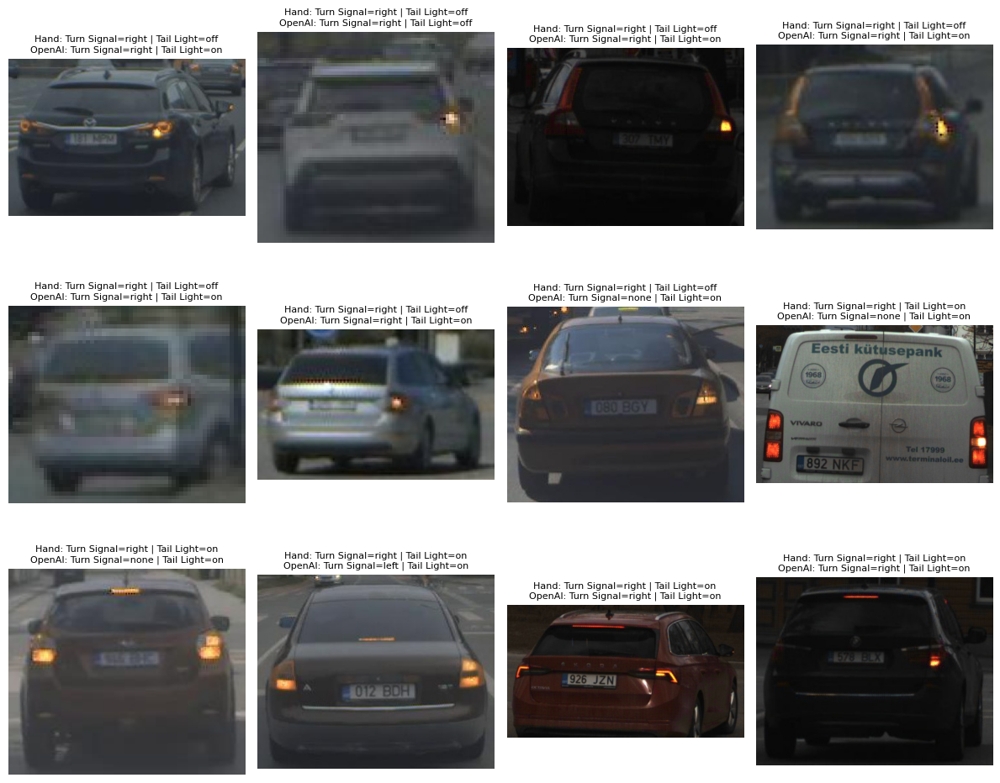

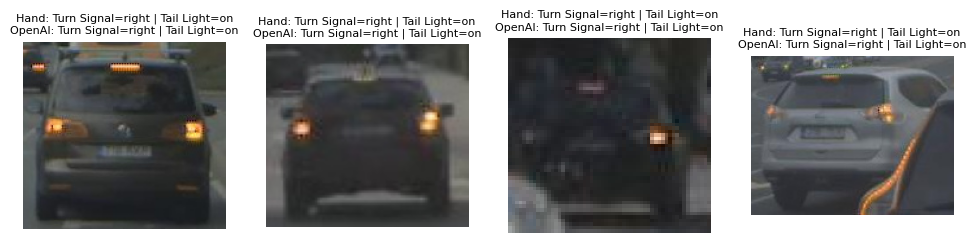

In [20]:
RESULTS_PATH = "../json_txt/gpt-4o_prompt3_wednesday.json"
LOCAL_BASE = "../sampled_images"

with open(RESULTS_PATH) as f:
    results = json.load(f)

# Display 12 images per page
for i, entry in enumerate(results[:100]):
    if i % 12 == 0:
        plt.figure(figsize=(12, 10))
    plt.subplot(3, 4, (i % 12) + 1)
    img_path = os.path.join(LOCAL_BASE, entry["image"].lstrip("/"))
    try:
        img = mpimg.imread(img_path)
        plt.imshow(img)
        plt.axis("off")
        plt.title(
            f"Hand: Turn Signal={entry['hand_label']['turn_signal']} | Tail Light={entry['hand_label']['tail_light']}\n"
            f"OpenAI: Turn Signal={entry['openai_label']['turn_signal']} | Tail Light={entry['openai_label']['tail_light']}",
            fontsize=8
        )
    except Exception as e:
        plt.title(f"Missing image: {e}")
    if (i + 1) % 12 == 0 or i == len(results) - 1:
        plt.tight_layout()
        plt.show()

### Metrics comparison

In [42]:
with open("../json_txt/gpt-4o_prompt3.json") as f:
    results = json.load(f)

total = len(results)
turn_correct = sum(r["hand_label"]["turn_signal"] == r["openai_label"]["turn_signal"] for r in results)
tail_correct = sum(r["hand_label"]["tail_light"] == r["openai_label"]["tail_light"] for r in results)

print(f"Turn signal accuracy: {turn_correct / total:.2%}")
print(f"Tail light accuracy: {tail_correct / total:.2%}")

Turn signal accuracy: 66.00%
Tail light accuracy: 50.00%
